# Setup

In [717]:
# Essential libraries
import os
import random
import itertools
from itertools import product, combinations
import multiprocessing
import math

# Numeric computation
import numpy as np
import torch
from scipy.linalg import cholesky  # For linear algebra (e.g., Cholesky decomposition)
from scipy.spatial import ConvexHull, Delaunay # For sampling and NTR
from scipy.optimize import minimize #For projection to the NTR
from scipy.spatial.distance import pdist, squareform #For projection to the NTR
# from scipy.special import roots_hermite # Polynomials of the form e^(-x^2)
# from scipy.special import roots_hermitenorm # Polynomials of the form e^(-x^(2)/2)
from scipy.optimize import least_squares
# Gaussian Process Regression (GPR)
import gpytorch
from gpytorch.models import ExactGP, ApproximateGP
from gpytorch.means import ConstantMean
from gpytorch.kernels import (Kernel, ScaleKernel, MaternKernel, 
                              GridInterpolationKernel, ProductKernel)
# from gpytorch.utils.grid import choose_grid_size
from gpytorch.likelihoods import GaussianLikelihood
from gpytorch.mlls import ExactMarginalLogLikelihood
from gpytorch.distributions import MultivariateNormal
from torch.nn import ModuleList  # Correct import for ModuleList (For SKIP)
# from gpytorch.lazy import MatmulLazyTensor, InterpolatedLazyTensor

from gpytorch.settings import fast_computations, lazily_evaluate_kernels, detach_test_caches, skip_posterior_variances
# from gpytorch.settings import fast_pred_var, fast_pred_samples

# Optimization
import cyipopt
from cyipopt import Problem

# Quasi-Monte Carlo (QMC) and sparse grids
# import Tasmanian  # Tasmanian Sparse Grid library
from Tasmanian import makeGlobalGrid
from torch.quasirandom import SobolEngine
import chaospy as cp

# We can save our No-trade-regions (Convex hulls) as .pkl files
import pickle
    #Save
    # with open("convex_hulls_array.pkl", "wb") as file:
    #     pickle.dump(convex_hulls, file)
    #Open
    # with open("convex_hulls_array.pkl", "rb") as file:
    #     loaded_hulls = pickle.load(file)

# Plotting
import matplotlib as mpl
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from cycler import cycler
import scienceplots  # For custom style based on science plots

# Parallel processing
from joblib import Parallel, delayed

# Logging configuration
import logging
logging.basicConfig(filename='optimization_log.txt', 
                    filemode='w',
                    level=logging.INFO, 
                    format='%(asctime)s - %(levelname)s - %(message)s')

# Random seed setup
random_seed = 1042023
torch.manual_seed(random_seed)
np.random.seed(random_seed)
random.seed(random_seed)
multiprocessing.set_start_method('spawn', force=True)

## Designing a custom plotting style and updating scienceplots

In [718]:
plt.style.use('science')

custom = True
if custom:

    colors = ['#094a84','#cc2300', 
                '#009437', '#cc7700',
                '#694878', '#383838',
                '#7e7e7e']
    mpl.rcParams['axes.prop_cycle'] = cycler('color', 
                                            ['#094a84','#cc2300', 
                                            '#009437', '#cc7700',
                                            '#694878', '#383838',
                                            '#7e7e7e'])

    mpl.rcParams['figure.facecolor'] = '#ffffff'  # Lightest Snow Storm background
    mpl.rcParams['axes.facecolor'] = '#FCFDFE'    # Same light background inside plots
    mpl.rcParams['axes.facecolor'] = '#ffffff'    # Same light background inside plots
    # mpl.rcParams['axes.facecolor'] = '#3B4252'    # Same light background inside plots
    # # mpl.rcParams['axes.facecolor'] = '#ffffff'    # Same light background inside plots
    # mpl.rcParams['axes.edgecolor'] = '#3B4252'    # Dark Slate from Polar Night for edges
    # mpl.rcParams['axes.labelcolor'] = '#3B4252'   # Text color for labels using Dark Slate
    # mpl.rcParams['xtick.color'] = '#3B4252'       # Tick color from Polar Night palette
    # mpl.rcParams['ytick.color'] = '#3B4252'

    mpl.rcParams['font.size'] = 11
    mpl.rcParams['axes.titlesize'] = 11
    mpl.rcParams['axes.labelsize'] = 11
    mpl.rcParams['legend.fontsize'] = 11

    # Remove spines
    # mpl.rcParams['axes.spines.top'] = False
    # mpl.rcParams['axes.spines.right'] = False
    # mpl.rcParams['axes.spines.bottom'] = False
    # mpl.rcParams['axes.spines.left'] = False

    # Grid settings
    mpl.rcParams['axes.grid'] = True
    mpl.rcParams['grid.color'] = '#e2e3e4'        # Subtle grid lines using light Snow Storm color
    mpl.rcParams['grid.linestyle'] = '--'
    mpl.rcParams['grid.linewidth'] = 0.8
    mpl.rcParams['axes.titlecolor'] = 'black'
    # Ticks
    mpl.rcParams['xtick.major.size'] = 5
    mpl.rcParams['ytick.major.size'] = 5
    mpl.rcParams['xtick.minor.size'] = 3
    mpl.rcParams['ytick.minor.size'] = 3
    mpl.rcParams['xtick.direction'] = 'in'
    mpl.rcParams['ytick.direction'] = 'in'

    # Lines and markers
    mpl.rcParams['lines.linewidth'] = 3
    mpl.rcParams['lines.markersize'] = 6
    mpl.rcParams['lines.markeredgewidth'] = 1.5

    # Legends
    mpl.rcParams['legend.frameon'] = True
    mpl.rcParams['legend.loc'] = 'best'

    # Subplots and layout
    mpl.rcParams['figure.figsize'] = [8, 6]
    mpl.rcParams['figure.dpi'] = 600
    mpl.rcParams['figure.autolayout'] = True

    # Always save as 'tight'
    mpl.rcParams['savefig.bbox'] = 'tight'
    mpl.rcParams['savefig.pad_inches'] = 0.02

    # Save figures to the folder Figures
    output_folder = '../Speciale dokumentet/Figures'
    os.makedirs(output_folder, exist_ok=True)

# Set parameters and load NTR

In [719]:
# Define parameters
def MertonPoint(mu, Sigma, r, gamma):
    Sigma_inv = np.linalg.inv(Sigma)
    mu_r = mu - r
    pi_star = (1.0 / gamma) * Sigma_inv.dot(mu_r)
    return pi_star


T = 15      # Number of time period (years)
Delta_t = 1.0 # time step (in years). Delta_t = T/M <=> M = T/Delta_t
M = int(T/Delta_t) # needs to be integer for the range function
# rho = 0.1 # Utility discount rate, see Cai Judd Xu.
# beta = np.exp(-rho*Delta_t)
beta = 0.97
tau = 0.00
fc = 0.0005

Schober_Parameters = False #Parameters of Schober 2020 
Cai_Judd_Identical = False #Assumes a correlation coefficent of 0
Cai_Judd_High_Correlation = True #Assumes a correlation coefficient of 0.75

if Schober_Parameters:
    gamma = 3.5
    r = np.round(np.log(1.0408),4)
    r = 0.03
    mu = np.array([0.0572, 0.0638, 0.07, 0.0764, 0.0828, 0.06, 0.07])
    # Sigma = np.array([
    #                 [0.0256, 0.00576, 0.00288, 0.00176, 0.00096], 
    #                 [0.00576, 0.0324, 0.0090432, 0.010692, 0.01296],
    #                 [0.00288, 0.0090432, 0.04, 0.0132, 0.0168],
    #                 [0.00176, 0.010692, 0.0132, 0.0484, 0.02112],
    #                 [0.00096, 0.01296, 0.0168, 0.02112, 0.0576]
    #                 ])
    
    Sigma = np.array([
        [0.0256, 0.00576, 0.00288, 0.00176, 0.00096, 0.002, -0.001], 
        [0.00576, 0.0324, 0.0090432, 0.010692, 0.01296, 0.0, -0.002],
        [0.00288, 0.0090432, 0.04, 0.0132, 0.0168, 0.0, -0.0015],
        [0.00176, 0.010692, 0.0132, 0.0484, 0.02112, 0.0, -0.001],
        [0.00096, 0.01296, 0.0168, 0.02112, 0.0576, 0.0, -0.0005],
        [0.002, 0.0, 0.0, 0.0, 0.0, 0.02, 0.0],
        [-0.001, -0.002, -0.0015, -0.001, -0.0005, 0.0, 0.025]
    ])

if Cai_Judd_Identical:
    gamma = 3.0
    r = np.log(np.round(np.exp(0.03),4))
    r = 0.03
    mu = np.array([0.07, 0.07, 0.07, 0.07,0.07])
    Sigma = np.array([
                    [0.04, 0.00, 0.00, 0.00, 0.00], 
                    [0.00, 0.04, 0.00, 0.00, 0.00],
                    [0.00, 0.00, 0.04, 0.00, 0.00],
                    [0.00, 0.00, 0.00, 0.04, 0.00],
                    [0.00, 0.00, 0.00, 0.00, 0.04]
                    ])

if Cai_Judd_High_Correlation:
    gamma = 3.0
    r = np.log(np.round(np.exp(0.03),5))
    r = 0.03
    mu = np.array([0.07, 0.07, 0.07, 0.07,0.07])
    Sigma = np.array([
                    [0.04, 0.03, 0.03, 0.03, 0.03], 
                    [0.03, 0.04, 0.03, 0.03, 0.03],
                    [0.03, 0.03, 0.04, 0.03, 0.03],
                    [0.03, 0.03, 0.03, 0.04, 0.03],
                    [0.03, 0.03, 0.03, 0.03, 0.04]
                    ])
Rf = np.exp(r*Delta_t)


def select_mu_sigma(mu, Sigma, D):
    """
    Selects the first D elements from mu and the corresponding D x D submatrix from Sigma.
    """
    selected_mu = mu[:D]
    selected_Sigma = Sigma[:D, :D]
    return selected_mu, selected_Sigma

D = 2
W = 100 # 1000 dollars
include_consumption = False  # Set to False if consumption is not included
c_min = 0.0  # Minimum consumption for numerical stability
if not include_consumption:
    c_min = 0.0

# if Cai_Judd_High_Correlation and fc > 0:
#     gamma = 3.0
#     r = np.log(np.round(np.exp(0.03),5))
#     r = 0.03
#     mu = np.array([0.075, 0.075, 0.075, 0.075,0.075])
#     Sigma = np.array([
#                     [0.04, 0.03, 0.03, 0.03, 0.03], 
#                     [0.03, 0.04, 0.03, 0.03, 0.03],
#                     [0.03, 0.03, 0.04, 0.03, 0.03],
#                     [0.03, 0.03, 0.03, 0.04, 0.03],
#                     [0.03, 0.03, 0.03, 0.03, 0.04]
#                     ])

mu, Sigma = select_mu_sigma(mu, Sigma, D)


# number_of_quadrature_points = 5 # In each dimension #Only for old quad
merton_p = MertonPoint(mu, Sigma, r, gamma)


In [720]:
mu

array([0.07, 0.07])

In [721]:
if fc == 0:
    def is_inside_hull(point, hull):
        """
        Check if a point is inside the convex hull using Delaunay triangulation.

        Args:
            point (array-like): Point to check, shape (D,)
            hull (ConvexHull): ConvexHull object.

        Returns:
            bool: True if inside, False otherwise.
        """
        if not hasattr(hull, 'delaunay'):
            hull.delaunay = Delaunay(hull.points[hull.vertices])
        return hull.delaunay.find_simplex(point) >= 0

    def in_hull_constraints(x, hull):
        """
        Define constraints for optimization to keep x on the hull.

        Since ConvexHull defines a convex set, we can use the inequalities:
            A * x <= b

        Args:
            x (array-like): Point to constrain, shape (D,)
            hull (ConvexHull): ConvexHull object.

        Returns:
            array-like: Constraint violations.
        """
        return np.dot(hull.equations[:,:-1], x) + hull.equations[:,-1]
    def project_onto_convex_hull(x, convex_hull):
        """
        Projects point x onto the convex hull defined by convex_hull.
        This is used in order to generate direction of optimization.
        When we already have an idea of the NTR

        Args:
            x (np.array): Current position. Shape: [D]
            convex_hull (scipy.spatial.ConvexHull): Convex hull of the NTR.

        Returns:
            np.array: Projected point within the convex hull.
        """
        D = x.shape[0]
        hull_eq = convex_hull.equations  # Shape: [num_facets, D+1]
        A = hull_eq[:, :-1]  # Coefficients of inequalities
        b = -hull_eq[:, -1]  # Constants of inequalities

        # Objective function (squared distance) (euclidian norm)
        def objective(x_proj):
            return np.sum((x_proj - x) ** 2)

        # Define the constraints (x_proj inside convex hull)
        constraints = [{'type': 'ineq', 'fun': lambda x_proj, A_row=A[i], b_val=b[i]: b_val - np.dot(A_row, x_proj)} for i in range(len(b))]

        # Variable bounds (e.g., x_proj between 0 and 1)
        bounds = [(0, 1) for _ in range(D)]

        # Initial guess for x_proj (could be current x)
        x0 = np.copy(x)

        # Solve the optimization problem
        # result = minimize(objective, x0, bounds=bounds, constraints=constraints, tol=1e-6)
        # Solve the optimization problem
        result = minimize(
            objective,
            x0,
            method='SLSQP',
            bounds=bounds,
            constraints=constraints,
            options={'ftol': 1e-5, 'disp': False}
        )
        if result.success:
            x_proj = result.x
            return x_proj
        else:
            print(f"Projection to hull failed. point = {x}")
            return None

if fc > 0:
    class EllipseConvexHull:
        def __init__(self, center, A):
            """
            Represents an elliptical convex region defined by:
            (x - center)^T A (x - center) <= 1
            
            Args:
                center (np.array): Center of the ellipse (D-dimensional).
                A (np.array): A positive definite symmetric matrix (D x D).
            """
            self.center = np.array(center)
            self.A = A  # Should be positive definite and symmetric

        def contains(self, point):
            """
            Check if a point is inside or on the boundary of the ellipse.

            (x - c)^T A (x - c) <= 1
            
            Args:
                point (np.array): D-dimensional point to check.
            
            Returns:
                bool: True if inside or on ellipse, False otherwise.
            """
            point = np.array(point)
            diff = point - self.center
            val = diff @ self.A @ diff
            return val <= 1.0

        def __repr__(self):
            return f"EllipseConvexHull(center={self.center}, A={self.A})"

    def project_onto_convex_hull(x, convex_hull):
        """
        Projects point x onto the convex hull defined by convex_hull (ellipse).
        If the point is outside the convex hull, it is projected to the center.
        If the point is inside, it remains unchanged.

        Args:
            x (np.array): Current position. Shape: [D]
            convex_hull (EllipseConvexHull): Elliptical convex hull.

        Returns:
            np.array: Projected point (center if outside, else the original point).
        """
        x = np.array(x)
        if convex_hull.contains(x):
            # Point is inside the convex hull; return it unchanged
            return x
        else:
            # Point is outside the convex hull; project it to the center
            return convex_hull.center.copy()
        
    def is_inside_hull(x, ellipse, delta_plus=None, delta_minus=None, epsilon_ntr=1e-5, t=None):
        """
        Determines whether each point in x is inside the NTR (ellipse).

        Args:
            x (torch.Tensor): Points to check. Shape: [n_points, D]
            ellipse (EllipseConvexHull or None): Ellipse defining the NTR.
            delta_plus (torch.Tensor or None): Adjustments (increases). Shape: [n_points, D]
            delta_minus (torch.Tensor or None): Adjustments (decreases). Shape: [n_points, D]
            epsilon_ntr (float): Tolerance.
            t (int): Current time step.

        Returns:
            torch.Tensor: Boolean tensor indicating NTR membership. Shape: [n_points]
        """
        # if x is not a tensor make it a tensor
        if not torch.is_tensor(x):
            x = torch.tensor(x, dtype=torch.float64)

        # if xt only has one dimensions give it one more
        if x.dim() == 1:
            x = x.unsqueeze(0)
        if ellipse is None:
            return torch.zeros(x.size(0), dtype=torch.bool)

        with torch.no_grad():
            # For each point, check (x_i - c)^T A (x_i - c) <= 1
            center = torch.tensor(ellipse.center, dtype=torch.float64)
            diff = x - center
            # Compute quadratic form for each x_i
            val = torch.einsum('ij,jk,ik->i', diff, torch.tensor(ellipse.A, dtype=torch.float64), diff)
            in_ellipse = val <= (1.0 + epsilon_ntr)

            if delta_plus is not None and delta_minus is not None:
                delta = delta_plus - delta_minus
                delta_policy = torch.all(torch.abs(delta) < epsilon_ntr, dim=-1)  # [n_points]
                return torch.logical_or(in_ellipse, delta_policy)
            
            return in_ellipse


In [722]:
# Choose the parameter prefix based on the active parameter set
if fc > 0:
    filename_beginning = 'Fixed_Cost_'
else:
    filename_beginning = ''
if Schober_Parameters:
    filename_prefix = "Schober_Parameters"
elif Cai_Judd_Identical:
    filename_prefix = "Cai_Identical"
elif Cai_Judd_High_Correlation:
    filename_prefix = "Cai_High_Correlation"
else:
    filename_prefix = "Unknown_Parameters"

if include_consumption:
    consumption = "_with_consumption"
else:
    consumption = "_no_consumption"
# Construct the full file path
if fc > 0:
    filename = f"{filename_beginning}NTR_Fixed_{filename_prefix}_{D}d_fc_{fc}_{consumption}.pkl"
else:
    filename = f"{filename_beginning}NTR_{filename_prefix}_d{D}_tau_{tau}_{consumption}.pkl"
# filename = f"{filename_beginning}NTR_{filename_prefix}_d{D}_fc_{fc}_{consumption}_T_{T}.pkl"
filename

'Fixed_Cost_NTR_Fixed_Cai_High_Correlation_2d_fc_0.0005__no_consumption.pkl'

In [723]:

def load_ntr_array_from_file(filename):
    """
    Loads the NTR array from a pickle file.

    Parameters:
    - filename: The name of the file to load.

    Returns:
    - The NTR array (list of ConvexHull objects or None).
    """
    # Ensure the "NTRs" folder exists
    os.makedirs("NTRs", exist_ok=True)

    # Construct the full file path
    full_filename = os.path.join("NTRs", filename)

    with open(full_filename, "rb") as file:
        NTR = pickle.load(file)
    print(f"NTR array loaded from {full_filename}")
    return NTR

# Choose the parameter prefix based on the active parameter set
# Choose the parameter prefix based on the active parameter set
if Schober_Parameters:
    filename_prefix = "Fixed_Schober_Parameters"
elif Cai_Judd_Identical:
    filename_prefix = "Fixed_Cai_Identical"
elif Cai_Judd_High_Correlation:
    filename_prefix = "Fixed_Cai_High_Correlation"
else:
    filename_prefix = "Fixed_Unknown_Parameters"

NTR = load_ntr_array_from_file(filename)
NTR
# Fixed_Cost_NTR_Fixed_Cai_High_Correlation_2d_fc_0.0005__no_consumption
# Fixed_Cost_NTR_Cai_High_Correlation_2d_fc_0.0005__no_consumption.pkl'

NTR array loaded from NTRs/Fixed_Cost_NTR_Fixed_Cai_High_Correlation_2d_fc_0.0005__no_consumption.pkl


[EllipseConvexHull(center=[0.18985727 0.18985728], A=[[116.32509215  86.38061628]
  [ 86.38061628 116.29373155]]),
 EllipseConvexHull(center=[0.1896993  0.18996856], A=[[116.24665658  86.33154045]
  [ 86.33154045 116.2197287 ]]),
 EllipseConvexHull(center=[0.19049714 0.19049714], A=[[118.23351987  88.16778632]
  [ 88.16778632 117.96938691]]),
 EllipseConvexHull(center=[0.19049714 0.19049714], A=[[117.8733224   87.7509833 ]
  [ 87.7509833  118.65056627]]),
 EllipseConvexHull(center=[0.18985732 0.18985722], A=[[116.31300686  86.61262986]
  [ 86.61262986 116.41556369]]),
 EllipseConvexHull(center=[0.18985727 0.18985728], A=[[58.21283086 43.35849295]
  [43.35849295 58.17203433]])]

In [724]:
def draw_lognormal_samples(T, mu, Sigma, Delta_t,seed=12102001):
    """
    Draws T samples from a log-normal distribution.

    Args:
        T (int): Number of time periods (samples).
        mu (ndarray): Mean vector of the log-normal distribution.
        Sigma (ndarray): Covariance matrix of the log-normal distribution.
        Delta_t (float): Time step (used to adjust the mean).

    Returns:
        ndarray: A (T, D) array of samples where D is the dimensionality of mu.
    """
    D = len(mu)  # Dimensionality of the assets
    
    # Adjust the mean for the log-normal distribution
    mu_adjusted = mu * Delta_t - 0.5 * np.diag(Sigma) * Delta_t
    np.random.seed(seed)
    # Generate T samples from a multivariate normal distribution
    Z = np.random.multivariate_normal(mu_adjusted, Sigma * Delta_t, size=T)
    
    # Transform to log-normal space
    lognormal_samples = np.exp(Z)
    
    return lognormal_samples

# Select mu and Sigma for D dimensions
mu, Sigma = select_mu_sigma(mu, Sigma, D)

# Draw log-normal samples
samples = draw_lognormal_samples(1000, mu, Sigma, Delta_t,0)
R_samples = torch.tensor(samples, dtype=torch.float64)  # Shape: (T, D)
# Print the results
print(f"Log-normal samples shape: {samples.shape}")
print(samples)
#Mean of each sample
mean_samples = np.mean(samples, axis=0)
print(mean_samples)


Log-normal samples shape: (1000, 2)
[[0.73468065 0.77745572]
 [0.74709705 1.02567401]
 [0.79430789 0.69177668]
 ...
 [1.00609622 1.02010112]
 [0.79979168 0.81791402]
 [1.42807845 1.1864084 ]]
[1.07634152 1.07522476]


In [725]:
mu

array([0.07, 0.07])

In [726]:
# Dynamics are normalized wrt. to wealth.
def normalized_bond_holdings(xt, delta_plus, delta_minus, tau, fc=0.0, Delta_t=1.0, ct=None, include_consumption=False):
    # This function is more similar to Schober 2022
    if not include_consumption:
        ct = torch.tensor([0.0], dtype=torch.float64)
    # if ct is None:
    #     ct = torch.tensor([0.0], dtype=torch.float64)

    # Ensure ct is a scalar tensor
    if ct.dim() == 0:
        ct = ct  # Already scalar
    else:
        ct = ct.squeeze()  # Convert [1] to scalar tensor []

    # # if torch sum xt > 1 then normalize it
    # if torch.sum(xt) > 1:
    #     xt = xt / torch.sum(xt)
        
    # Available cash before transactions
    available_cash = 1.0 - torch.sum(xt)

    # Buying and selling costs
    buying_cost = (1.0 + tau) * torch.sum(delta_plus)
    selling_proceeds = (1.0 - tau) * torch.sum(delta_minus)

    # pay fc if any delta plus or delta minus > 0
    if torch.sum(delta_plus) > 0 or torch.sum(delta_minus) > 0:
        buying_cost += fc

    # Calculate bond holdings (bt)
    bt = available_cash - buying_cost + selling_proceeds - torch.sum(ct) * Delta_t
    bt = 1.0 - torch.sum(xt) -  torch.sum(delta_plus) + torch.sum(delta_minus) - tau*torch.sum(delta_plus) - tau*torch.sum(delta_minus) - torch.sum(ct) * Delta_t
    # bt = torch.abs(bt)  # Ensure bond holdings are non-negative
    return bt

def normalized_state_dynamics(xt, delta_plus, delta_minus, Rt, bt, Rf, tau):
    """
    Handles both single and batched Rt inputs.

    Args:
        xt (torch.Tensor): Current state allocations. Shape: [1, D]
        delta_plus (torch.Tensor): Adjustments (increases). Shape: [1, D]
        delta_minus (torch.Tensor): Adjustments (decreases). Shape: [1, D]
        Rt (torch.Tensor): Returns. Shape: [D] or [n_samples, D]
        bt (torch.Tensor or float): Bond holdings.
        Rf (float): Risk-free rate factor.
        tau (float): Transaction cost rate.

    Returns:
        pi_t1 (torch.Tensor): Next period's portfolio value. Shape: [1] or [n_samples]
        xt1 (torch.Tensor): Next period's state allocation proportions. Shape: [D] or [n_samples, D]
        Wt1 (torch.Tensor): Wealth factor (scalar or [n_samples])
    """
    # Convert inputs to tensors if necessary
    if not torch.is_tensor(bt):
        bt = torch.tensor(bt, dtype=torch.float64)
    if not torch.is_tensor(Rf):
        Rf = torch.tensor(Rf, dtype=torch.float64)

    # Squeeze the first dimension if necessary
    xt = xt.squeeze(0)          # Shape: [D]
    delta_plus = delta_plus.squeeze(0)    # Shape: [D]
    delta_minus = delta_minus.squeeze(0)  # Shape: [D]

    # Calculate asset adjustments
    asset_adjustment = xt + delta_plus - delta_minus  # Shape: [D]

    # Check if Rt is batched
    if Rt.dim() == 1:
        # Single Rt
        portfolio_returns = asset_adjustment * Rt  # Shape: [D]
        pi_t1 = bt * Rf + torch.sum(portfolio_returns)  # Scalar (float)
        pi_t1 = torch.tensor(pi_t1, dtype=torch.float64)  # Ensure tensor
        xt1 = portfolio_returns / pi_t1  # Shape: [D]
        Wt1 = pi_t1  # Scalar
    else:
        # Batched Rt
        # Rt: [n_samples, D]
        portfolio_returns = asset_adjustment.unsqueeze(0) * Rt  # Shape: [n_samples, D]
        pi_t1 = bt * Rf + torch.sum(portfolio_returns, dim=1)   # Shape: [n_samples]
        xt1 = portfolio_returns / pi_t1.unsqueeze(1)  # Shape: [n_samples, D]
        Wt1 = pi_t1  # Shape: [n_samples]

    return pi_t1, xt1


In [727]:
# ----- Initialize Holdings and Wealth for Both Strategies -----
# NTR-Constrained Strategy
# xt_ntr = torch.zeros(D, dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
xt_ntr = torch.tensor([0.5, 0.5], dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
bt_ntr = (1.0 - torch.sum(xt_ntr)).clone()  # Initial bond holdings
Wt_ntr = torch.tensor(W, dtype=torch.float64)  # Initial Wealth

# Merton Strategy
# xt_merton = torch.zeros(D, dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
xt_merton = torch.tensor([0.5, 0.5], dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
bt_merton = (1.0 - torch.sum(xt_merton)).clone()  # Initial bond holdings
Wt_merton = torch.tensor(W, dtype=torch.float64)  # Initial Wealth

# ----- Initialize Tracking Lists for Both Strategies -----
# NTR-Constrained Strategy Tracking
track_xt_ntr = [xt_ntr.clone()]
# track_xt_trade_ntr = []
track_bt_ntr = [bt_ntr.clone()]
track_bt_ntr = []
track_Wt_ntr = [Wt_ntr.clone()]
track_delta_plus_ntr = []
track_delta_minus_ntr = []
track_delta_ntr = []
track_actual_xt_ntr = [xt_ntr.clone() * Wt_ntr]
track_actual_bt_ntr = [bt_ntr.clone() * Wt_ntr]
# track_actual_bt_ntr = []
track_delta_plus_actual_ntr = []
track_delta_minus_actual_ntr = []
track_delta_actual_ntr = []
track_pi_t_ntr = []

# Merton Strategy Tracking
track_xt_merton = [xt_merton.clone()]
track_bt_merton = [bt_merton.clone()]
track_bt_merton = []
track_Wt_merton = [Wt_merton.clone()]
track_delta_plus_merton = []
track_delta_minus_merton = []
track_delta_merton = []
track_actual_xt_merton = [xt_merton.clone() * Wt_merton]
track_actual_bt_merton = [bt_merton.clone() * Wt_merton]
# track_actual_bt_merton = []
track_delta_plus_actual_merton = []
track_delta_minus_actual_merton = []
track_delta_actual_merton = []
track_pi_t_merton = []



In [728]:
T=5

In [729]:
# ----- Simulation Loop -----
for t in range(T):
    # -------------------
    # NTR-Constrained Strategy
    # -------------------
    if Wt_ntr > 0:
        hull_ntr = NTR[t]
        xt_ntr_np = xt_ntr.numpy()

        # Check if xt_ntr is inside the NTR
        inside_ntr = is_inside_hull(xt_ntr_np, hull_ntr)

        if inside_ntr:
            delta_plus_ntr = torch.zeros(D, dtype=torch.float64)
            delta_minus_ntr = torch.zeros(D, dtype=torch.float64)
        else:
            # Project xt_ntr to the nearest point on the hull
            projected_xt_ntr = project_onto_convex_hull(xt_ntr_np, hull_ntr)
            delta_ntr = torch.tensor(projected_xt_ntr, dtype=torch.float64) - xt_ntr
            # Split delta into delta_plus and delta_minus
            delta_plus_ntr = torch.clamp(delta_ntr, min=0.0)
            delta_minus_ntr = torch.clamp(-delta_ntr, min=0.0)

        # Track delta_plus and delta_minus
        track_delta_plus_ntr.append(delta_plus_ntr.clone())
        track_delta_minus_ntr.append(delta_minus_ntr.clone())


        # Calculate actual delta values by scaling with Wealth
        delta_plus_actual_ntr = delta_plus_ntr * Wt_ntr
        delta_minus_actual_ntr = delta_minus_ntr * Wt_ntr
        track_delta_plus_actual_ntr.append(delta_plus_actual_ntr.clone())
        track_delta_minus_actual_ntr.append(delta_minus_actual_ntr.clone())

        # Update bond holdings using normalized_bond_holdings
        bt_ntr = normalized_bond_holdings(
            xt=xt_ntr,
            delta_plus=delta_plus_ntr,
            delta_minus=delta_minus_ntr,
            tau=tau,
            fc=fc,
            Delta_t=Delta_t,
            ct=None,  # Assuming no consumption
            include_consumption=False
        )
        track_bt_ntr.append(bt_ntr.clone())

        # Update holdings based on state dynamics
        Rt_ntr = R_samples[t]  # Returns for this period, shape: (D,)
        pi_t1_ntr, xt1_ntr = normalized_state_dynamics(
            xt=xt_ntr.unsqueeze(0),          # Shape: [1, D]
            delta_plus=delta_plus_ntr.unsqueeze(0),    # Shape: [1, D]
            delta_minus=delta_minus_ntr.unsqueeze(0),  # Shape: [1, D]
            Rt=Rt_ntr,                                  # Shape: (D,)
            bt=bt_ntr,                                  # Scalar
            Rf=Rf,
            tau=tau
        )

        # Update Wealth
        Wt1_ntr = Wt_ntr * pi_t1_ntr
        track_Wt_ntr.append(Wt1_ntr.clone())

        # Update holdings
        xt_ntr = xt1_ntr.squeeze(0)
        track_xt_ntr.append(xt_ntr.clone())

        # Track actual holdings
        actual_xt_ntr = xt_ntr * Wt_ntr
        track_actual_xt_ntr.append(actual_xt_ntr.clone())
        actual_bt_ntr = bt_ntr * Wt_ntr
        track_actual_bt_ntr.append(actual_bt_ntr.clone())

        # Track pi_t
        track_pi_t_ntr.append(pi_t1_ntr.clone())
    else:
        # Wealth is zero; append zeros for future periods
        track_delta_plus_ntr.append(torch.zeros(D, dtype=torch.float64))
        track_delta_minus_ntr.append(torch.zeros(D, dtype=torch.float64))
        track_delta_plus_actual_ntr.append(torch.zeros(D, dtype=torch.float64))
        track_delta_minus_actual_ntr.append(torch.zeros(D, dtype=torch.float64))
        track_bt_ntr.append(torch.tensor(0.0, dtype=torch.float64))
        track_Wt_ntr.append(torch.tensor(0.0, dtype=torch.float64))
        track_xt_ntr.append(torch.zeros(D, dtype=torch.float64))
        track_actual_xt_ntr.append(torch.zeros(D, dtype=torch.float64))
        track_actual_bt_ntr.append(torch.tensor(0.0, dtype=torch.float64))
        track_pi_t_ntr.append(torch.tensor(1.0, dtype=torch.float64))  # No change

    # -------------------
    # Merton Strategy
    # -------------------
    if Wt_merton > 0:
        # Desired allocation is the Merton Point
        desired_xt_merton = torch.tensor(merton_p).clone()

        # Calculate delta to reach the Merton Point
        delta_merton = desired_xt_merton - xt_merton

        # Split delta into delta_plus and delta_minus
        delta_plus_merton = torch.clamp(delta_merton, min=0.0)
        delta_minus_merton = torch.clamp(-delta_merton, min=0.0)

        # Track delta_plus and delta_minus
        track_delta_plus_merton.append(delta_plus_merton.clone())
        track_delta_minus_merton.append(delta_minus_merton.clone())

        # Calculate actual delta values by scaling with Wealth
        delta_plus_actual_merton = delta_plus_merton * Wt_merton
        delta_minus_actual_merton = delta_minus_merton * Wt_merton
        track_delta_plus_actual_merton.append(delta_plus_actual_merton.clone())
        track_delta_minus_actual_merton.append(delta_minus_actual_merton.clone())

        # Update bond holdings using normalized_bond_holdings
        bt_merton = normalized_bond_holdings(
            xt=xt_merton,
            delta_plus=delta_plus_merton,
            delta_minus=delta_minus_merton,
            tau=tau,
            fc=fc,
            Delta_t=Delta_t,
            ct=None,  # Assuming no consumption
            include_consumption=False
        )
        track_bt_merton.append(bt_merton.clone())

        # Update holdings based on state dynamics
        Rt_merton = R_samples[t]  # Returns for this period, shape: (D,)
        pi_t_merton, xt1_merton = normalized_state_dynamics(
            xt=xt_merton.unsqueeze(0),          # Shape: [1, D]
            delta_plus=delta_plus_merton.unsqueeze(0),    # Shape: [1, D]
            delta_minus=delta_minus_merton.unsqueeze(0),  # Shape: [1, D]
            Rt=Rt_merton,                                  # Shape: (D,)
            bt=bt_merton,                                  # Scalar
            Rf=Rf,
            tau=tau
        )

        # Update Wealth
        Wt_merton = Wt_merton * pi_t_merton
        track_Wt_merton.append(Wt_merton.clone())

        # Update holdings
        xt_merton = xt1_merton.squeeze(0)
        track_xt_merton.append(xt_merton.clone())

        # Track actual holdings
        actual_xt_merton = xt_merton * Wt_merton
        track_actual_xt_merton.append(actual_xt_merton.clone())
        actual_bt_merton = bt_merton * Wt_merton
        track_actual_bt_merton.append(actual_bt_merton.clone())

        # Track pi_t
        track_pi_t_merton.append(pi_t_merton.clone())
    else:
        # Wealth is zero; append zeros for future periods
        track_delta_plus_merton.append(torch.zeros(D, dtype=torch.float64))
        track_delta_minus_merton.append(torch.zeros(D, dtype=torch.float64))
        track_delta_plus_actual_merton.append(torch.zeros(D, dtype=torch.float64))
        track_delta_minus_actual_merton.append(torch.zeros(D, dtype=torch.float64))
        track_bt_merton.append(torch.tensor(0.0, dtype=torch.float64))
        track_Wt_merton.append(torch.tensor(0.0, dtype=torch.float64))
        track_xt_merton.append(torch.zeros(D, dtype=torch.float64))
        track_actual_xt_merton.append(torch.zeros(D, dtype=torch.float64))
        track_actual_bt_merton.append(torch.tensor(0.0, dtype=torch.float64))
        track_pi_t_merton.append(torch.tensor(1.0, dtype=torch.float64))  # No change

# ----- Convert Tracking Lists to Tensors for Analysis -----

# NTR-Constrained Strategy
track_xt_ntr = torch.stack(track_xt_ntr)[0:T]              # Shape: (T+1, D)
track_bt_ntr = torch.stack(track_bt_ntr)[0:T]              # Shape: (T+1,)
track_Wt_ntr = torch.stack(track_Wt_ntr)[0:T]              # Shape: (T+1,)
track_delta_plus_ntr = torch.stack(track_delta_plus_ntr)[0:T]      # Shape: (T, D)
track_delta_minus_ntr = torch.stack(track_delta_minus_ntr)[0:T]    # Shape: (T, D)
track_delta_ntr = track_delta_plus_ntr - track_delta_minus_ntr  # Shape: (T, D)
track_actual_xt_ntr = torch.stack(track_actual_xt_ntr)[0:T]        # Shape: (T+1, D)
track_actual_bt_ntr = torch.stack(track_actual_bt_ntr)[0:T]        # Shape: (T+1,)
track_delta_plus_actual_ntr = torch.stack(track_delta_plus_actual_ntr)[0:T]  # Shape: (T, D)
track_delta_minus_actual_ntr = torch.stack(track_delta_minus_actual_ntr)[0:T]  # Shape: (T, D)
track_delta_actual_ntr = track_delta_plus_actual_ntr - track_delta_minus_actual_ntr  # Shape: (T, D)
track_pi_t_ntr = torch.stack(track_pi_t_ntr)[0:T]        # Shape: (T,)

# Merton Strategy
track_xt_merton = torch.stack(track_xt_merton)[0:T]              # Shape: (T+1, D)
track_bt_merton = torch.stack(track_bt_merton)[0:T]              # Shape: (T+1,)
track_Wt_merton = torch.stack(track_Wt_merton)[0:T]              # Shape: (T+1,)
track_delta_plus_merton = torch.stack(track_delta_plus_merton)[0:T]      # Shape: (T, D)
track_delta_minus_merton = torch.stack(track_delta_minus_merton)[0:T]    # Shape: (T, D)
track_delta_merton = track_delta_plus_merton - track_delta_minus_merton  # Shape: (T, D)
track_actual_xt_merton = torch.stack(track_actual_xt_merton)[0:T]        # Shape: (T+1, D)
track_actual_bt_merton = torch.stack(track_actual_bt_merton)[0:T]        # Shape: (T+1,)
track_delta_plus_actual_merton = torch.stack(track_delta_plus_actual_merton)[0:T]  # Shape: (T, D)
track_delta_minus_actual_merton = torch.stack(track_delta_minus_actual_merton)[0:T]  # Shape: (T, D)
track_delta_actual_merton = track_delta_plus_actual_merton - track_delta_minus_actual_merton  # Shape: (T, D)
track_pi_t_merton = torch.stack(track_pi_t_merton)[0:T]        # Shape: (T,)

/var/folders/hz/t94d7ym95fx1sf3fpl6b9bcm0000gn/T/ipykernel_88779/4060988272.py:73: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pi_t1 = torch.tensor(pi_t1, dtype=torch.float64)  # Ensure tensor


# Plotting both side by side

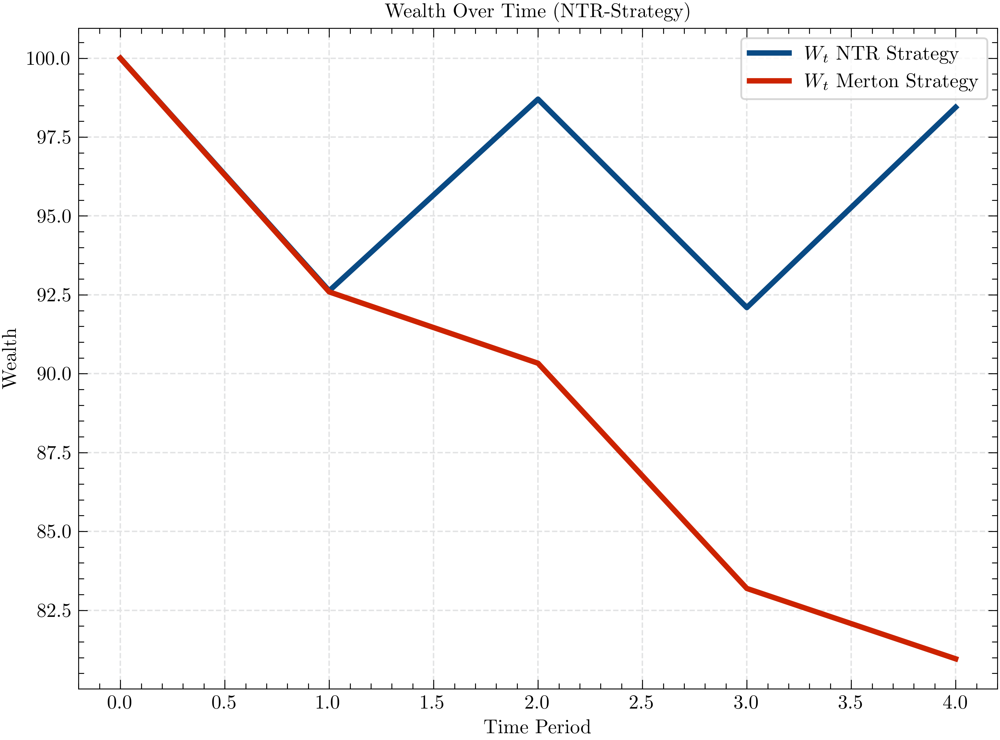

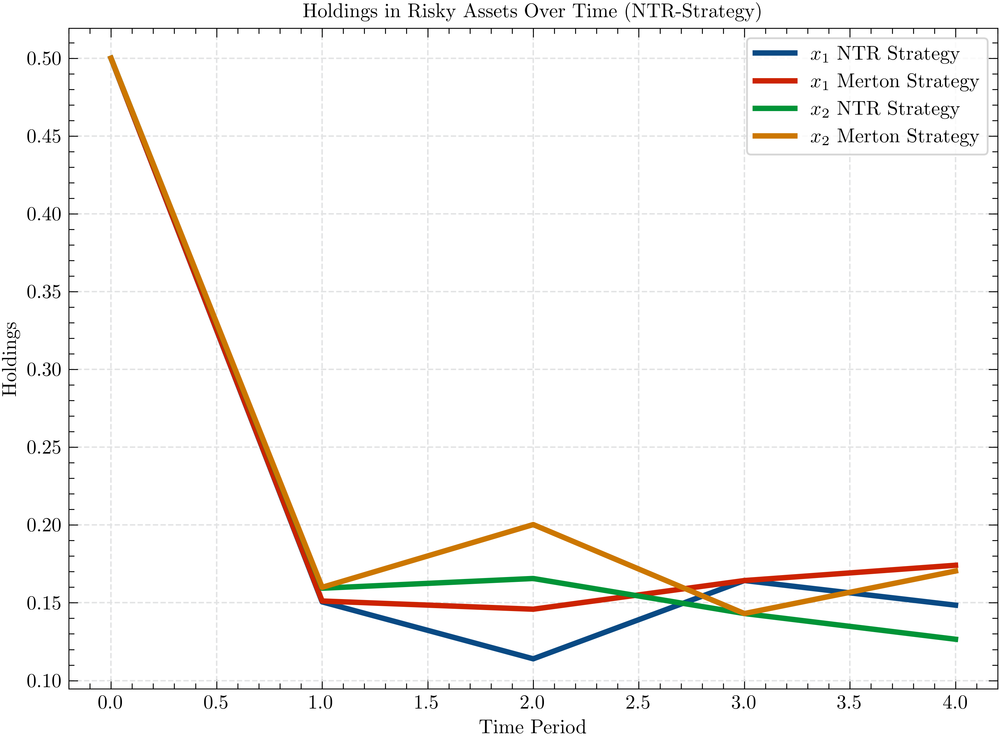

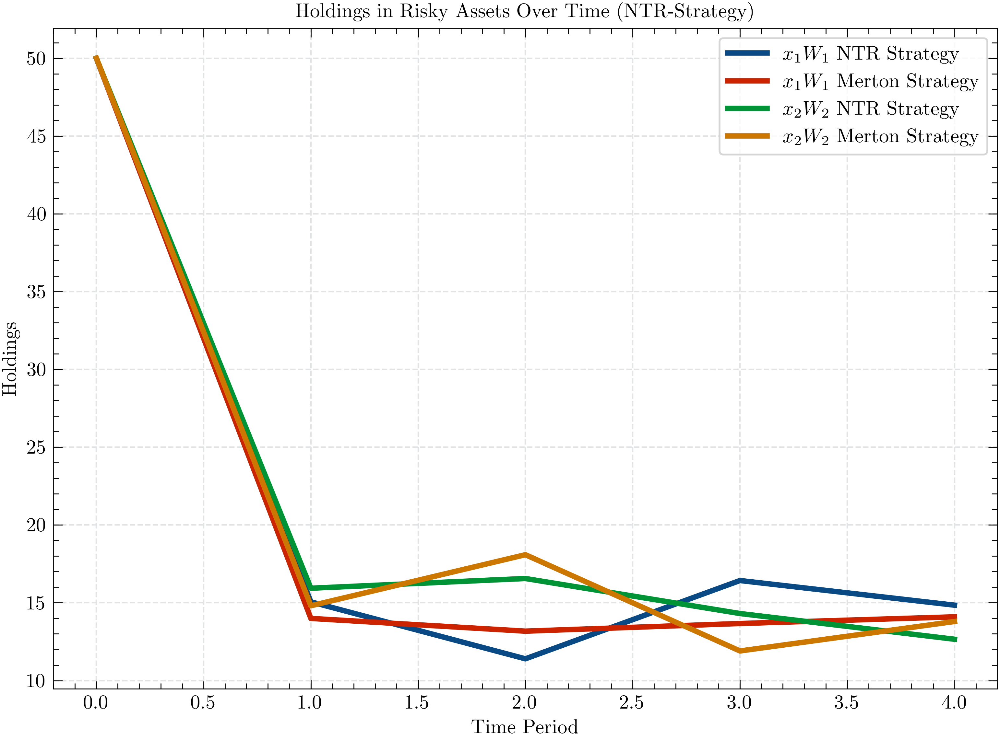

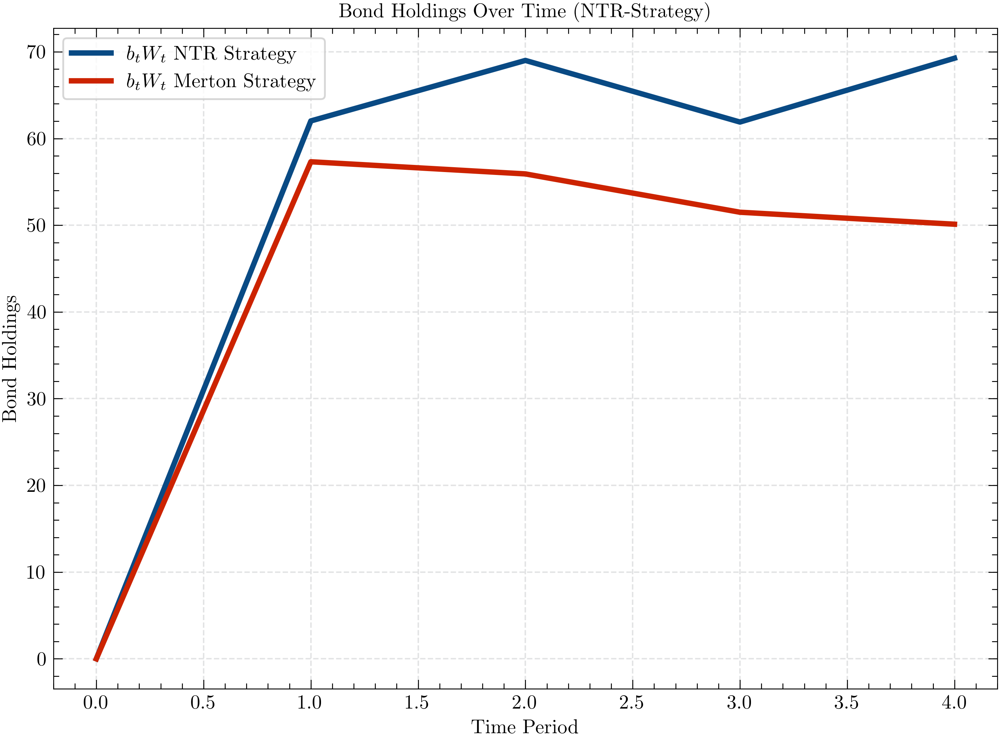

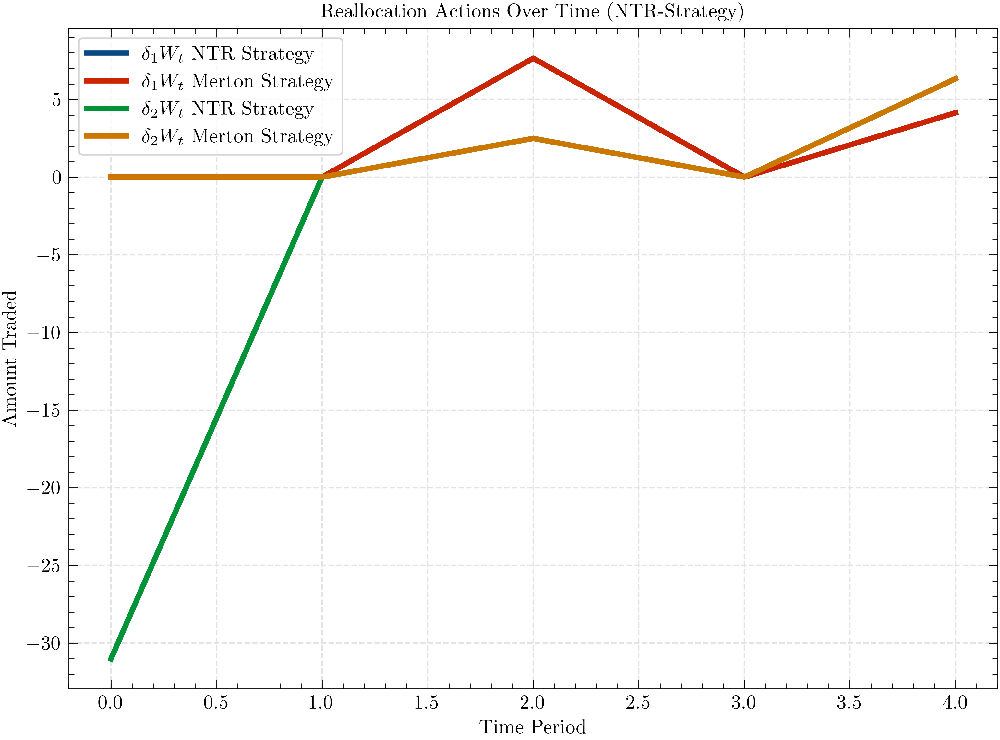

In [730]:
# ----- Visualization for NTR-Constrained Strategy -----
time_periods = np.arange(T)
time_periods_merton = np.arange(T)

# Plot Wealth over time (NTR-Constrained)
plt.figure(figsize=(8, 6), dpi=400)
plt.plot(time_periods, track_Wt_ntr.numpy(),label=f'$W_t$ NTR Strategy')
plt.plot(time_periods_merton, track_Wt_merton.numpy(),label=f'$W_t$ Merton Strategy')
plt.title('Wealth Over Time (NTR-Strategy)')
plt.xlabel('Time Period')
plt.ylabel('Wealth')
plt.legend()
plt.grid(True)
plt.show()

# Plot relative Holdings in Risky Assets over time (NTR-Constrained)
plt.figure(figsize=(8, 6), dpi=400)
for d in range(D):
    plt.plot(time_periods, track_xt_ntr[:, d].numpy(), label=f'$x_{d+1}$ NTR Strategy')
    plt.plot(time_periods_merton, track_xt_merton[:, d].numpy(), label=f'$x_{d+1}$ Merton Strategy')
plt.title('Holdings in Risky Assets Over Time (NTR-Strategy)')
plt.xlabel('Time Period')
plt.ylabel('Holdings')
plt.legend()
plt.grid(True)
plt.show()
# Plot Holdings in Risky Assets over time (NTR-Constrained)
plt.figure(figsize=(8, 6), dpi=400)
for d in range(D):
    plt.plot(time_periods, track_actual_xt_ntr[:, d].numpy(), label=f'$x_{d+1} W_{d+1}$ NTR Strategy')
    plt.plot(time_periods_merton, track_actual_xt_merton[:, d].numpy(), label=f'$x_{d+1} W_{d+1}$ Merton Strategy')
plt.title('Holdings in Risky Assets Over Time (NTR-Strategy)')
plt.xlabel('Time Period')
plt.ylabel('Holdings')
plt.legend()
plt.grid(True)
plt.show()

# Plot Bond Holdings over time (NTR-Constrained)
plt.figure(figsize=(8, 6), dpi=400)
plt.plot(time_periods, track_actual_bt_ntr.numpy(), label=f'$b_t W_t$ NTR Strategy')
plt.plot(time_periods_merton, track_actual_bt_merton.numpy(), label=f'$b_t W_t$ Merton Strategy')
plt.title('Bond Holdings Over Time (NTR-Strategy)')
plt.xlabel('Time Period')
plt.ylabel('Bond Holdings')
plt.legend()
plt.grid(True)
plt.show()

# Plot Trading Actions (delta_plus and delta_minus) (NTR-Constrained)
plt.figure(figsize=(8, 6), dpi=400)
for d in range(D):
    plt.plot(np.arange(T), track_delta_actual_ntr[:, d].numpy(), label=f'$\delta_{d+1} W_t$ NTR Strategy')
    plt.plot(np.arange(T), track_delta_plus_actual_ntr[:, d].numpy(), label=f'$\delta_{d+1} W_t$ Merton Strategy')
    # plt.plot(np.arange(T), track_delta_plus_actual_ntr[:, d].numpy(), label=f'$\delta+^{{Asset {d+1}}}$')
    # plt.plot(np.arange(T), track_delta_minus_actual_ntr[:, d].numpy(), label=f'$\delta-^{{Asset {d+1}}}$')
plt.title('Reallocation Actions Over Time (NTR-Strategy)')
plt.xlabel('Time Period')
plt.ylabel('Amount Traded')
plt.legend()
plt.grid(True)
plt.show()

# Monte Carlo simulation

In [731]:
import numpy as np
import torch
from scipy.spatial import ConvexHull, Delaunay
from scipy.optimize import minimize
import matplotlib.pyplot as plt
import os
import pickle
import random
import multiprocessing

def simulation_run(NTR, params, seed=None):
    """
    Performs a single simulation run for both NTR-Constrained and Merton Strategies.

    Args:
        NTR (list of ConvexHull): List of convex hulls representing NTR for each time period.
        params (dict): Dictionary containing all necessary parameters.
        seed (int, optional): Random seed for reproducibility.

    Returns:
        dict: Contains tracked variables for both strategies.
    """
    # Unpack parameters
    T = params['T']
    Delta_t = params['Delta_t']
    D = params['D']
    W = params['W']
    mu = params['mu']
    Sigma = params['Sigma']
    r = params['r']
    gamma = params['gamma']
    tau = params['tau']
    fc = params['fc']
    Rf = params['Rf']
    include_consumption = params['include_consumption']
    
    # Set seeds for reproducibility
    if seed is not None:
        torch.manual_seed(seed)
        np.random.seed(seed)
        random.seed(seed)
    
    # Calculate Merton Point (static over time)
    merton_p = MertonPoint(mu, Sigma, r, gamma)  # Shape: (D,)
    
    # Initialize Holdings and Wealth for Both Strategies
    
    # NTR-Constrained Strategy
    # xt_ntr = torch.zeros(D, dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
    xt_ntr = torch.tensor([0.5, 0.5], dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
    bt_ntr = (1.0 - torch.sum(xt_ntr)).clone()  # Initial bond holdings
    # bt_ntr = torch.tensor(1.0, dtype=torch.float64)  # Initial bond holdings
    Wt_ntr = torch.tensor(W, dtype=torch.float64)  # Initial Wealth
    
    # Merton Strategy
    # xt_merton = torch.zeros(D, dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
    xt_merton = torch.tensor([0.5, 0.5], dtype=torch.float64)  # Initial holdings in risky assets: [0.0, 0.0]
    bt_merton = (1.0 - torch.sum(xt_merton)).clone()  # Initial bond holdings
    Wt_merton = torch.tensor(W, dtype=torch.float64)  # Initial Wealth
    
    # Initialize Tracking Lists for Both Strategies
    
    # NTR-Constrained Strategy Tracking
    track_xt_ntr = [xt_ntr.clone()]
    track_bt_ntr = [bt_ntr.clone()]
    track_Wt_ntr = [Wt_ntr.clone()]
    track_xt_traded_ntr = []
    track_delta_plus_ntr = []
    track_delta_minus_ntr = []
    track_delta_actual_ntr = []
    track_actual_xt_ntr = [xt_ntr.clone() * Wt_ntr]
    track_actual_bt_ntr = [bt_ntr.clone() * Wt_ntr]
    track_delta_plus_actual_ntr = []
    track_delta_minus_actual_ntr = []
    track_pi_t_ntr = []
    
    # Merton Strategy Tracking
    track_xt_merton = [xt_merton.clone()]
    track_bt_merton = [bt_merton.clone()]
    track_Wt_merton = [Wt_merton.clone()]
    track_xt_traded_merton = []
    track_delta_plus_merton = []
    track_delta_minus_merton = []
    track_delta_actual_merton = []
    track_actual_xt_merton = [xt_merton.clone() * Wt_merton]
    track_actual_bt_merton = [bt_merton.clone() * Wt_merton]
    track_delta_plus_actual_merton = []
    track_delta_minus_actual_merton = []
    track_pi_t_merton = []
    
    # Draw log-normal samples for returns (R_t)
    samples = draw_lognormal_samples(T, mu, Sigma, Delta_t, seed=seed)
    R_samples = torch.tensor(samples, dtype=torch.float64)  # Shape: (T, D)
    
    # Simulation Loop
    for t in range(T):
        # -------------------
        # NTR-Constrained Strategy
        # -------------------
        if Wt_ntr > 0:
            # hull_ntr = NTR[t]
            if t < T - 1:
                hull_ntr = NTR[-2]
            else:
                hull_ntr = NTR[-1]
            xt_ntr_np = xt_ntr.numpy()
    
            # Check if xt_ntr is inside the NTR
            inside_ntr = is_inside_hull(xt_ntr_np, hull_ntr)
    
            if inside_ntr:
                delta_plus_ntr = torch.zeros(D, dtype=torch.float64)
                delta_minus_ntr = torch.zeros(D, dtype=torch.float64)
            else:
                # Project xt_ntr to the nearest point on the hull
                projected_xt_ntr = project_onto_convex_hull(xt_ntr_np, hull_ntr)
                if projected_xt_ntr is None:
                    # If projection failed, do not adjust holdings
                    delta_plus_ntr = torch.zeros(D, dtype=torch.float64)
                    delta_minus_ntr = torch.zeros(D, dtype=torch.float64)
                else:
                    delta_ntr = torch.tensor(projected_xt_ntr, dtype=torch.float64) - xt_ntr
                    # Split delta into delta_plus and delta_minus
                    delta_plus_ntr = torch.clamp(delta_ntr, min=0.0)
                    delta_minus_ntr = torch.clamp(-delta_ntr, min=0.0)

            # Track delta_plus and delta_minus
            track_delta_plus_ntr.append(delta_plus_ntr.clone())
            track_delta_minus_ntr.append(delta_minus_ntr.clone())
            # Calculate actual delta values by scaling with Wealth
            delta_plus_actual_ntr = delta_plus_ntr * Wt_ntr
            delta_minus_actual_ntr = delta_minus_ntr * Wt_ntr
            track_delta_plus_actual_ntr.append(delta_plus_actual_ntr.clone())
            track_delta_minus_actual_ntr.append(delta_minus_actual_ntr.clone())
    
            # Calculate total delta (reallocation actions)
            delta_actual_ntr = delta_plus_actual_ntr - delta_minus_actual_ntr
            track_xt_traded_ntr.append((xt_ntr + delta_plus_ntr - delta_minus_ntr).clone())
            track_delta_actual_ntr.append(delta_actual_ntr.clone())
    
            # Update bond holdings using normalized_bond_holdings
            bt_ntr = normalized_bond_holdings(
                xt=xt_ntr,
                delta_plus=delta_plus_ntr,
                delta_minus=delta_minus_ntr,
                tau=tau,
                fc=fc,
                Delta_t=Delta_t,
                ct=None,  # Assuming no consumption
                include_consumption=False
            )
            track_bt_ntr.append(bt_ntr.clone())
    
            # Update holdings based on state dynamics
            Rt_ntr = R_samples[t]  # Returns for this period, shape: (D,)
            pi_t_ntr, xt1_ntr = normalized_state_dynamics(
                xt=xt_ntr.unsqueeze(0),          # Shape: [1, D]
                delta_plus=delta_plus_ntr.unsqueeze(0),    # Shape: [1, D]
                delta_minus=delta_minus_ntr.unsqueeze(0),  # Shape: [1, D]
                Rt=Rt_ntr,                                  # Shape: (D,)
                bt=bt_ntr,                                  # Scalar
                Rf=Rf,
                tau=tau
            )
    
            # Update Wealth
            Wt_ntr = Wt_ntr * pi_t_ntr
            track_Wt_ntr.append(Wt_ntr.clone())
    
            # Update holdings
            xt_ntr = xt1_ntr.squeeze(0)
            track_xt_ntr.append(xt_ntr.clone())
    
            # Track actual holdings
            actual_xt_ntr = xt_ntr * Wt_ntr
            track_actual_xt_ntr.append(actual_xt_ntr.clone())
            actual_bt_ntr = bt_ntr * Wt_ntr
            track_actual_bt_ntr.append(actual_bt_ntr.clone())
    
            # Track pi_t
            track_pi_t_ntr.append(pi_t_ntr.clone())
        else:
            # Wealth is zero; append zeros for future periods
            track_delta_plus_ntr.append(torch.zeros(D, dtype=torch.float64))
            track_delta_minus_ntr.append(torch.zeros(D, dtype=torch.float64))
            track_delta_plus_actual_ntr.append(torch.zeros(D, dtype=torch.float64))
            track_delta_minus_actual_ntr.append(torch.zeros(D, dtype=torch.float64))
            track_delta_actual_ntr.append(torch.zeros(D, dtype=torch.float64))
            track_bt_ntr.append(torch.tensor(0.0, dtype=torch.float64))
            track_Wt_ntr.append(torch.tensor(0.0, dtype=torch.float64))
            track_xt_ntr.append(torch.zeros(D, dtype=torch.float64))
            track_actual_xt_ntr.append(torch.zeros(D, dtype=torch.float64))
            track_actual_bt_ntr.append(torch.tensor(0.0, dtype=torch.float64))
            track_pi_t_ntr.append(torch.tensor(1.0, dtype=torch.float64))  # No change
    
        # -------------------
        # Merton Strategy
        # -------------------
        if Wt_merton > 0:
            # Desired allocation is the Merton Point
            # tau = 0.01
            desired_xt_merton = torch.tensor(merton_p, dtype=torch.float64).clone()
    
            # Calculate delta to reach the Merton Point
            delta_merton = desired_xt_merton - xt_merton
            # Split delta into delta_plus and delta_minus
            delta_plus_merton = torch.clamp(delta_merton, min=0.0)
            delta_minus_merton = torch.clamp(-delta_merton, min=0.0)
    
            # Track delta_plus and delta_minus
            track_delta_plus_merton.append(delta_plus_merton.clone())
            track_delta_minus_merton.append(delta_minus_merton.clone())
    
            # Calculate actual delta values by scaling with Wealth
            delta_plus_actual_merton = delta_plus_merton * Wt_merton
            delta_minus_actual_merton = delta_minus_merton * Wt_merton
            track_delta_plus_actual_merton.append(delta_plus_actual_merton.clone())
            track_delta_minus_actual_merton.append(delta_minus_actual_merton.clone())

            track_xt_traded_merton.append((xt_merton + delta_plus_merton - delta_minus_merton).clone())

            # Calculate total delta (reallocation actions)
            delta_actual_merton = delta_plus_actual_merton - delta_minus_actual_merton
            track_delta_actual_merton.append(delta_actual_merton.clone())
    
            # Update bond holdings using normalized_bond_holdings
            bt_merton = normalized_bond_holdings(
                xt=xt_merton,
                delta_plus=delta_plus_merton,
                delta_minus=delta_minus_merton,
                tau=tau,
                fc=fc,
                Delta_t=Delta_t,
                ct=None,  # Assuming no consumption
                include_consumption=False
            )
            track_bt_merton.append(bt_merton.clone())
    
            # Update holdings based on state dynamics
            Rt_merton = R_samples[t]  # Returns for this period, shape: (D,)
            pi_t_merton, xt1_merton = normalized_state_dynamics(
                xt=xt_merton.unsqueeze(0),          # Shape: [1, D]
                delta_plus=delta_plus_merton.unsqueeze(0),    # Shape: [1, D]
                delta_minus=delta_minus_merton.unsqueeze(0),  # Shape: [1, D]
                Rt=Rt_merton,                                  # Shape: (D,)
                bt=bt_merton,                                  # Scalar
                Rf=Rf,
                tau=tau
            )
    
            # Update Wealth
            Wt_merton = Wt_merton * pi_t_merton
            track_Wt_merton.append(Wt_merton.clone())
    
            # Update holdings
            xt_merton = xt1_merton.squeeze(0)
            track_xt_merton.append(xt_merton.clone())
    
            # Track actual holdings
            actual_xt_merton = xt_merton * Wt_merton
            track_actual_xt_merton.append(actual_xt_merton.clone())
            actual_bt_merton = bt_merton * Wt_merton
            track_actual_bt_merton.append(actual_bt_merton.clone())
    
            # Track pi_t
            track_pi_t_merton.append(pi_t_merton.clone())
        else:
            # Wealth is zero; append zeros for future periods
            track_delta_plus_merton.append(torch.zeros(D, dtype=torch.float64))
            track_delta_minus_merton.append(torch.zeros(D, dtype=torch.float64))
            track_delta_plus_actual_merton.append(torch.zeros(D, dtype=torch.float64))
            track_delta_minus_actual_merton.append(torch.zeros(D, dtype=torch.float64))
            track_delta_actual_merton.append(torch.zeros(D, dtype=torch.float64))
            track_bt_merton.append(torch.tensor(0.0, dtype=torch.float64))
            track_Wt_merton.append(torch.tensor(0.0, dtype=torch.float64))
            track_xt_merton.append(torch.zeros(D, dtype=torch.float64))
            track_actual_xt_merton.append(torch.zeros(D, dtype=torch.float64))
            track_actual_bt_merton.append(torch.tensor(0.0, dtype=torch.float64))
            track_pi_t_merton.append(torch.tensor(1.0, dtype=torch.float64))  # No change
    
    # ----- Collect and Return Tracked Variables -----
    result = {
        'NTR': {
            'Wt': torch.stack(track_Wt_ntr).numpy()[:T],  # Shape: (T,)
            'xt': torch.stack(track_xt_ntr).numpy()[:T],  # Shape: (T+1, D)
            'bt': torch.stack(track_bt_ntr).numpy()[:T],  # Shape: (T+1,)
            'delta': torch.stack(track_delta_plus_ntr).numpy()[:T] - torch.stack(track_delta_minus_ntr).numpy()[:T],  # Shape: (T, D)
            'delta_plus': torch.stack(track_delta_plus_ntr).numpy()[:T],  # Shape: (T, D)
            'delta_minus': torch.stack(track_delta_minus_ntr).numpy()[:T],  # Shape: (T, D)
            'xt_traded': torch.stack(track_xt_traded_ntr).numpy()[:T],  # Shape
        },
        'Merton': {
            'Wt': torch.stack(track_Wt_merton).numpy()[:T],  # Shape: (T+1,)
            'xt': torch.stack(track_xt_merton).numpy()[:T],  # Shape: (T+1, D)
            'bt': torch.stack(track_bt_merton).numpy()[:T],  # Shape: (T+1,)
            'delta': torch.stack(track_delta_plus_merton).numpy()[:T] - torch.stack(track_delta_minus_merton).numpy()[:T],  # Shape: (T, D)
            'delta_plus': torch.stack(track_delta_plus_merton).numpy()[:T],  # Shape: (T, D)
            'delta_minus': torch.stack(track_delta_minus_merton).numpy()[:T],  # Shape: (T, D)
            'xt_traded': torch.stack(track_xt_traded_merton).numpy()[:T],  # Shape: (T, D)
        },
        'Returns': samples  # Shape: (T, D)
    }
    
    return result


In [751]:
# ----- Define Simulation Parameters -----
T = 15
W = 100
params = {
    'T': T,  # Number of time periods
    'Delta_t': Delta_t,  # Time step
    'D': D,  # Number of assets
    'W': W,  # Starting Wealth
    'mu': mu,  # Mean returns
    'Sigma': Sigma,  # Covariance matrix
    'r': r,  # Risk-free rate
    'gamma': gamma,  # Risk aversion coefficient
    'tau': tau,  # Transaction cost rate
    'fc': fc,  # Fixed transaction cost
    'Rf': Rf,  # Risk-free rate factor
    'include_consumption': include_consumption  # Whether to include consumption
}
# ----- Monte Carlo Parameters -----
N_simulations = 499  # Number of Monte Carlo simulations



In [752]:
# ----- Perform Monte Carlo Simulations -----
results_NTR = {
    'Wt': [],
    'xt': [],
    'bt': [],
    'delta': [],
    'delta_plus': [],
    'delta_minus': [],
    'xt_traded': []
}

results_Merton = {
    'Wt': [],
    'xt': [],
    'bt': [],
    'delta': [],
    'delta_plus': [],
    'delta_minus': [],
    'xt_traded': []
}

returns_samples = []


random_seed=0
for sim in range(N_simulations):
    seed = random_seed + sim  # Different seed for each simulation
    simulation_result = simulation_run(NTR, params, seed=seed)
    
    # Append NTR results
    results_NTR['Wt'].append(simulation_result['NTR']['Wt'])  # Shape: (T+1,)
    results_NTR['xt'].append(simulation_result['NTR']['xt'])  # Shape: (T+1, D)
    results_NTR['bt'].append(simulation_result['NTR']['bt'])  # Shape: (T+1,)
    results_NTR['delta'].append(simulation_result['NTR']['delta'])  # Shape: (T, D)
    results_NTR['delta_plus'].append(simulation_result['NTR']['delta_plus'])  # Shape: (T, D)
    results_NTR['delta_minus'].append(simulation_result['NTR']['delta_minus'])  # Shape: (T, D)
    results_NTR['xt_traded'].append(simulation_result['NTR']['xt_traded'])  # Shape: (T, D)
    
    # Append Merton results
    results_Merton['Wt'].append(simulation_result['Merton']['Wt'])  # Shape: (T+1,)
    results_Merton['xt'].append(simulation_result['Merton']['xt'])  # Shape: (T+1, D)
    results_Merton['bt'].append(simulation_result['Merton']['bt'])  # Shape: (T+1,)
    results_Merton['delta'].append(simulation_result['Merton']['delta'])  # Shape: (T, D)
    results_Merton['delta_plus'].append(simulation_result['Merton']['delta_plus'])  # Shape: (T, D)
    results_Merton['delta_minus'].append(simulation_result['Merton']['delta_minus'])  # Shape: (T, D)
    results_Merton['xt_traded'].append(simulation_result['Merton']['xt_traded'])  # Shape: (T, D)
    
    # Append return samples
    returns_samples.append(simulation_result['Returns'])  # Shape: (T, D)

/var/folders/hz/t94d7ym95fx1sf3fpl6b9bcm0000gn/T/ipykernel_88779/4060988272.py:73: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  pi_t1 = torch.tensor(pi_t1, dtype=torch.float64)  # Ensure tensor


In [753]:
# ----- Compute Means Across Simulations -----

# Convert lists to NumPy arrays for easier manipulation
mean_NTR_Wt = np.mean(results_NTR['Wt'], axis=0)  # Shape: (T+1,)
mean_NTR_xt = np.mean(results_NTR['xt'], axis=0)  # Shape: (T+1, D)
mean_NTR_bt = np.mean(results_NTR['bt'], axis=0)  # Shape: (T+1,)
mean_NTR_delta = np.mean(results_NTR['delta'], axis=0)  # Shape: (T, D)
mean_NTR_delta_plus = np.mean(results_NTR['delta_plus'], axis=0)  # Shape: (T, D)
mean_NTR_delta_minus = np.mean(results_NTR['delta_minus'], axis=0)  # Shape: (T, D)
mean_NTR_xt_traded = np.mean(results_NTR['xt_traded'], axis=0)  # Shape: (T, D)

mean_Merton_Wt = np.mean(results_Merton['Wt'], axis=0)  # Shape: (T+1,)
mean_Merton_xt = np.mean(results_Merton['xt'], axis=0)  # Shape: (T+1, D)
mean_Merton_bt = np.mean(results_Merton['bt'], axis=0)  # Shape: (T+1,)
mean_Merton_delta = np.mean(results_Merton['delta'], axis=0)  # Shape: (T, D)
mean_Merton_delta_plus = np.mean(results_Merton['delta_plus'], axis=0)  # Shape: (T, D)
mean_Merton_delta_minus = np.mean(results_Merton['delta_minus'], axis=0)  # Shape: (T, D)
mean_Merton_xt_traded = np.mean(results_Merton['xt_traded'], axis=0)  # Shape: (T, D)

In [754]:
mean_Merton_xt_traded[:][:,0]

array([0.19047619, 0.19047619, 0.19047619, 0.19047619, 0.19047619,
       0.19047619, 0.19047619, 0.19047619, 0.19047619, 0.19047619,
       0.19047619, 0.19047619, 0.19047619, 0.19047619, 0.19047619])

In [755]:
# print final mean wealth
print(f"Final Mean Wealth (NTR): {mean_NTR_Wt}")
print(f"Final Mean Wealth (Merton): {mean_Merton_Wt}")


Final Mean Wealth (NTR): [100.         104.7223774  109.40072552 113.96987338 120.03404067
 126.62313813 132.8041039  138.95598445 145.14321727 151.84120904
 158.99325578 166.8710107  174.08655867 182.33343516 190.03873491]
Final Mean Wealth (Merton): [100.         104.72784407 109.37208003 113.94243224 119.91638499
 126.46313118 132.58853907 138.68437543 144.77609646 151.41130067
 158.49440358 166.32786926 173.62031754 181.76114096 189.2896059 ]


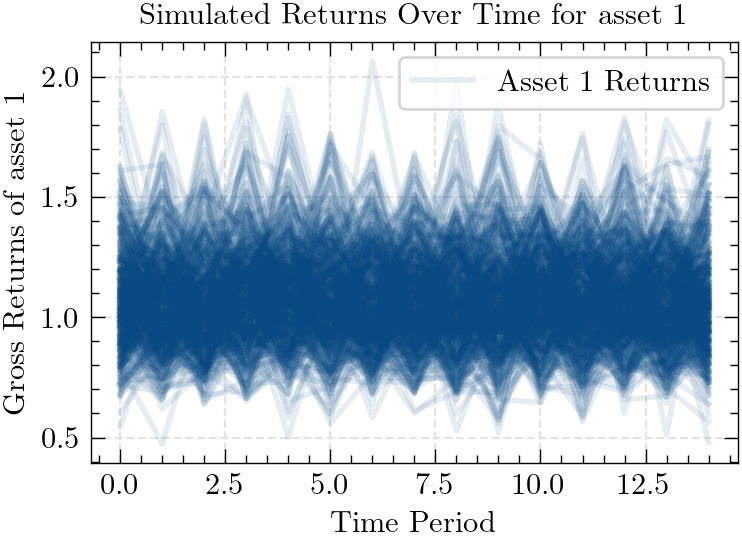

In [794]:
# ----- Random Returns -----
plt.figure(figsize=(4, 3), dpi=200)
for sim in range(N_simulations):
    # for d in range(D):
        # plt.plot(np.arange(T), samples[:, d][:T], label=f'Asset {d+1} Returns', alpha=0.9, linewidth=2)
    if sim == 0:
        plt.plot(np.arange(T), returns_samples[sim][:,0], label=f'Asset {1} Returns', alpha=0.1, linewidth=2, color=colors[0])
    else:
        plt.plot(np.arange(T), returns_samples[sim][:,0], alpha=0.1, linewidth=2, color=colors[0])

plt.title('Simulated Returns Over Time for asset 1')
plt.xlabel('Time Period')
plt.ylabel('Gross Returns of asset 1')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('../Speciale dokumentet/Figures/Simulated_Returns_Over_Time_1_FixedCost.png')
plt.show()

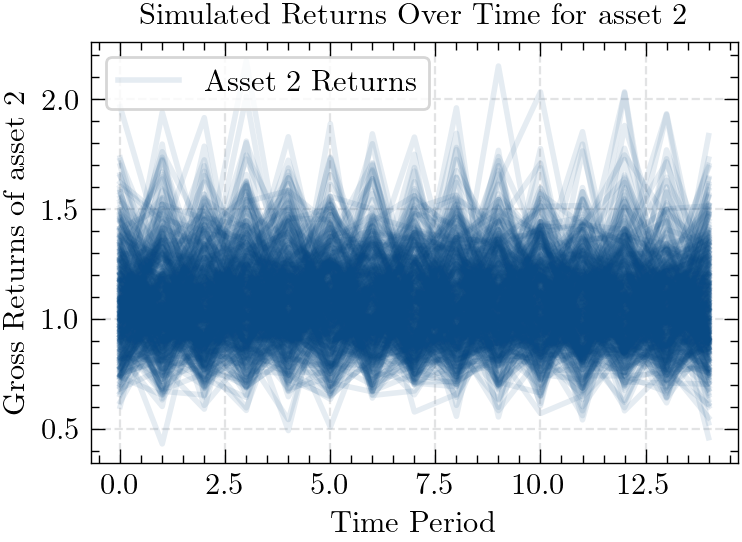

In [793]:
# ----- Random Returns -----
plt.figure(figsize=(4, 3), dpi=200)
for sim in range(N_simulations):
    # for d in range(D):
        # plt.plot(np.arange(T), samples[:, d][:T], label=f'Asset {d+1} Returns', alpha=0.9, linewidth=2)
    if sim == 0:
        plt.plot(np.arange(T), returns_samples[sim][:,1], label=f'Asset {2} Returns', alpha=0.1, linewidth=2, color=colors[0])
    else:
        plt.plot(np.arange(T), returns_samples[sim][:,1], alpha=0.1, linewidth=2, color=colors[0])

plt.title('Simulated Returns Over Time for asset 2')
plt.xlabel('Time Period')
plt.ylabel('Gross Returns of asset 2')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('../Speciale dokumentet/Figures/Simulated_Returns_Over_Time_2_FixedCost.png')
plt.show()

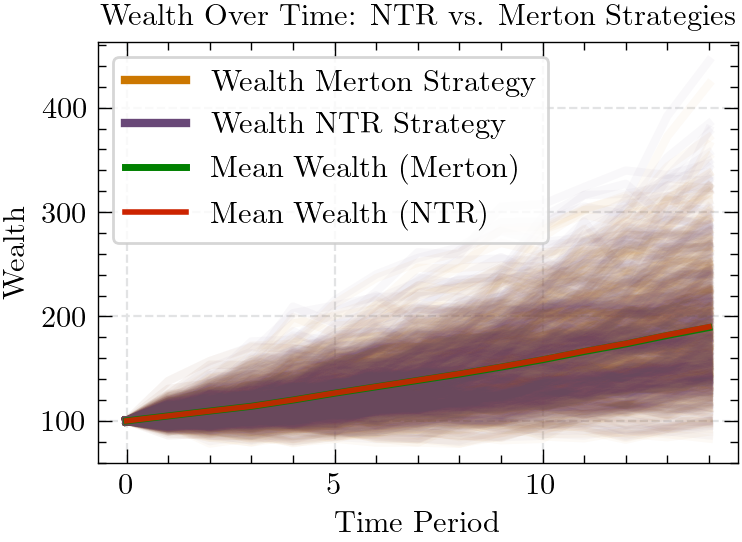

In [808]:
# ----- Wealth Over Time -----
plt.figure(figsize=(4, 3), dpi=200)


for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_Merton['Wt'][sim], color=colors[3], alpha=0.035, zorder=2, label='Wealth Merton Strategy')
    else:
        plt.plot(time_periods, results_Merton['Wt'][sim], color=colors[3], alpha=0.035, zorder=2)    

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['Wt'][sim], color=colors[4], alpha=0.035, zorder=3, label='Wealth NTR Strategy')
    else:
        plt.plot(time_periods, results_NTR['Wt'][sim], color=colors[4], alpha=0.035, zorder=3)
# Plot mean trajectories
plt.plot(time_periods, mean_Merton_Wt, label='Mean Wealth (Merton)', alpha=0.9, linewidth=2.5, zorder=4,color='green')
plt.plot(time_periods, mean_NTR_Wt, label='Mean Wealth (NTR)', alpha=0.9, linewidth=2, zorder=5,color=colors[1])

plt.title('Wealth Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Wealth')

# Create legend and remove alpha from legend handles
legend = plt.legend()
for handle in legend.legend_handles:
    handle.set_alpha(1.0)

plt.grid(True)
plt.tight_layout()
plt.savefig('../Speciale dokumentet/Figures/Simulated_Wealth_Over_Time_FixedCost.png')
plt.show()

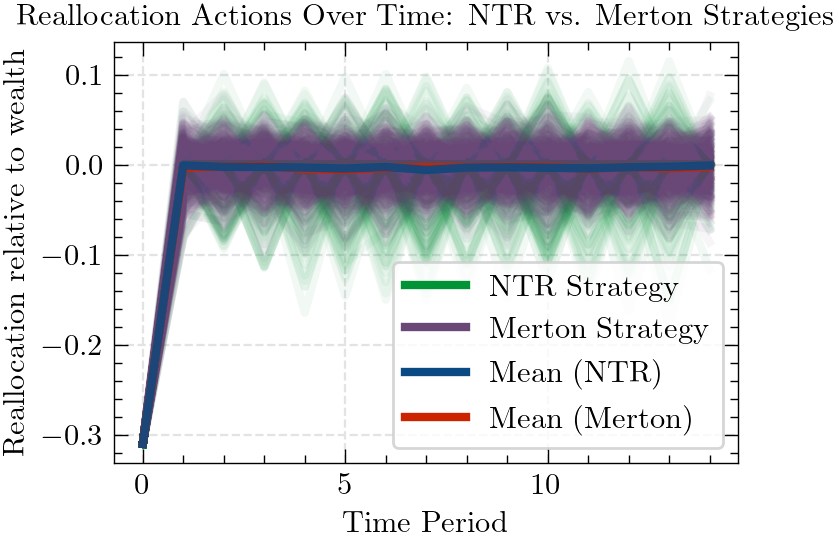

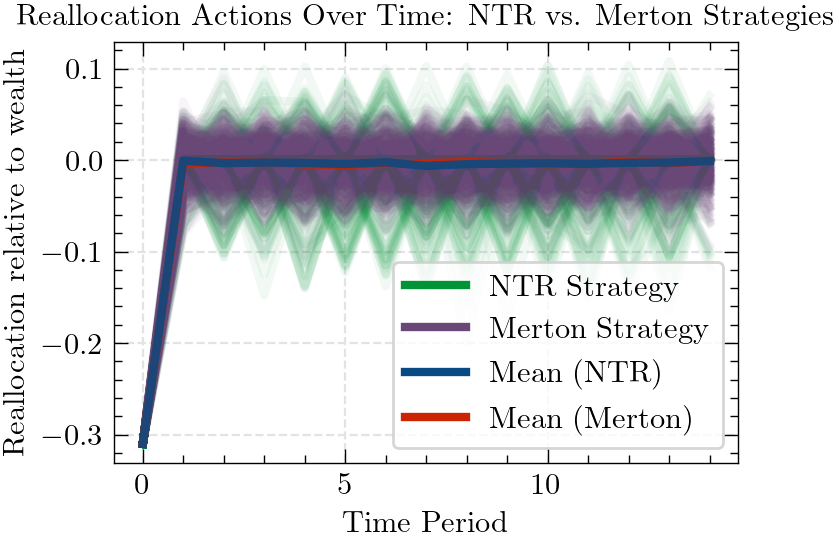

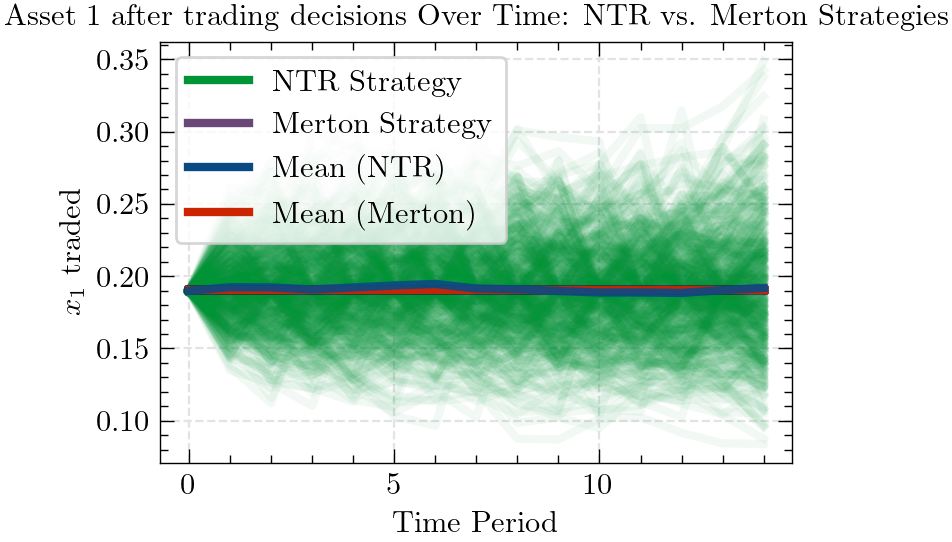

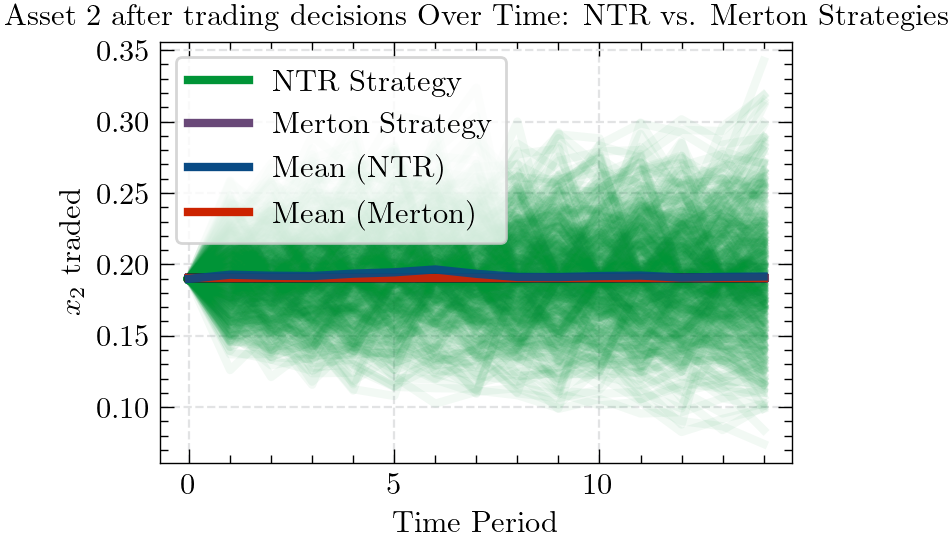

In [804]:
# ----- Reallocation Actions (Delta) Over Time -----
plt.figure(figsize=(4, 3), dpi=200)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2, label='NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2, label='Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_delta[:, 0], label='Mean (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_delta[:, 0], label='Mean (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Reallocation Actions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Reallocation relative to wealth')
legend = plt.legend()
for handle in legend.legend_handles:
    handle.set_alpha(1.0)
plt.grid(True)
plt.tight_layout()
plt.savefig('../Speciale dokumentet/Figures/Simulated_Reallocations_1_Over_Time_FixedCost.png')
plt.show()

plt.figure(figsize=(4, 3), dpi=200)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2, label='NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2, label='Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_delta[:, 1], label='Mean (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_delta[:, 1], label='Mean (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Reallocation Actions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Reallocation relative to wealth')
legend = plt.legend()
for handle in legend.legend_handles:
    handle.set_alpha(1.0)
plt.grid(True)
plt.tight_layout()
# Shrink current axis's height by 10% on the bottom
plt.savefig('../Speciale dokumentet/Figures/Simulated_Reallocations_2_Over_Time_FixedCost.png')
plt.show()

# ----- xt traded Over Time -----
plt.figure(figsize=(4, 3), dpi=200)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2, label='NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2, label='Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_xt_traded[:, 0], label='Mean (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_xt_traded[:, 0], label='Mean (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Asset 1 after trading decisions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('$x_{{1}}$ traded')
legend = plt.legend()
for handle in legend.legend_handles:
    handle.set_alpha(1.0)
plt.grid(True)
plt.tight_layout()
plt.savefig('../Speciale dokumentet/Figures/Simulated_xt1_traded_Over_Time_FixedCost.png')
plt.show()

# ----- xt traded Over Time -----
plt.figure(figsize=(4, 3), dpi=200)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2, label='NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2, label='Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_xt_traded[:, 1], label='Mean (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_xt_traded[:, 1], label='Mean (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Asset 2 after trading decisions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('$x_{{2}}$ traded')
legend = plt.legend()
for handle in legend.legend_handles:
    handle.set_alpha(1.0)
plt.grid(True)
plt.tight_layout()
plt.savefig('../Speciale dokumentet/Figures/Simulated_xt2_traded_Over_Time_FixedCost.png')
plt.show()


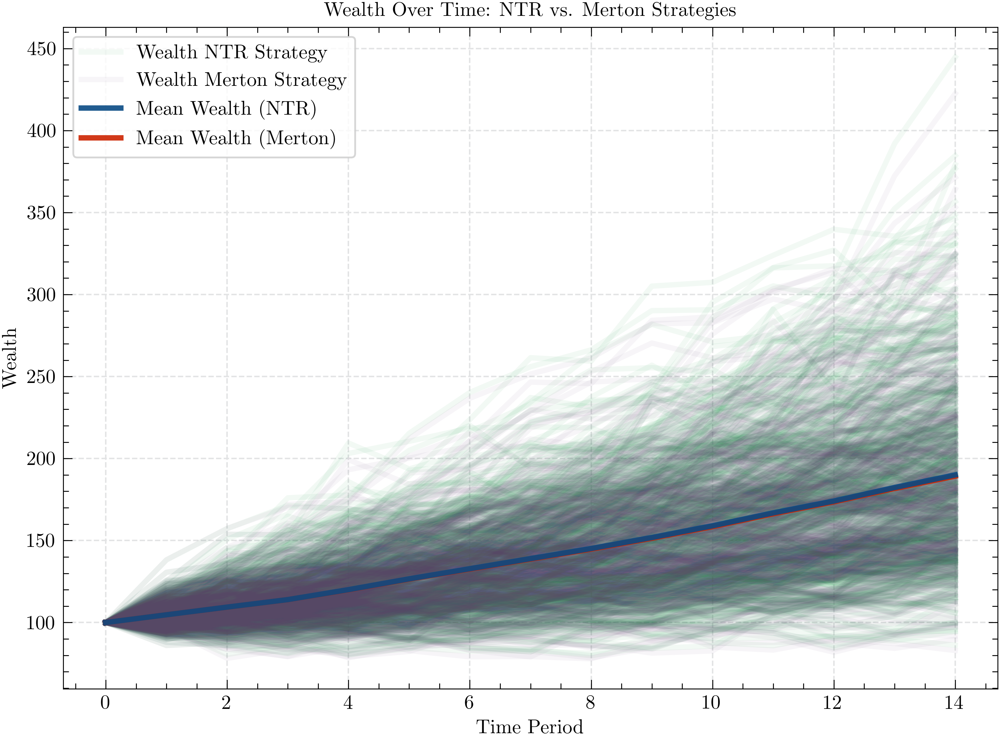

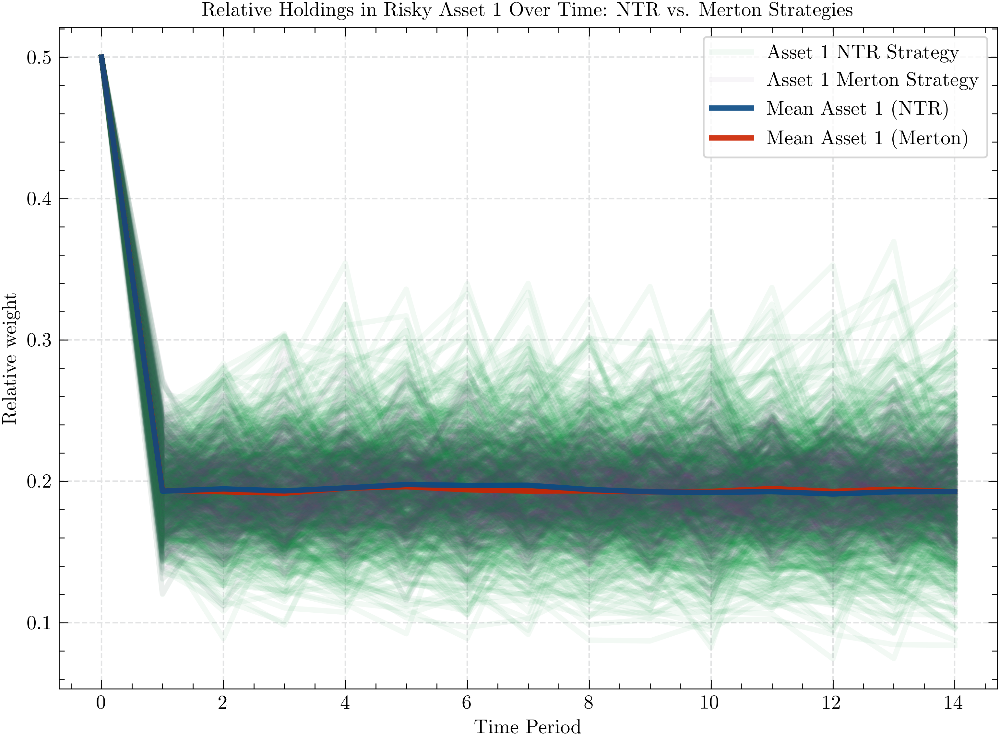

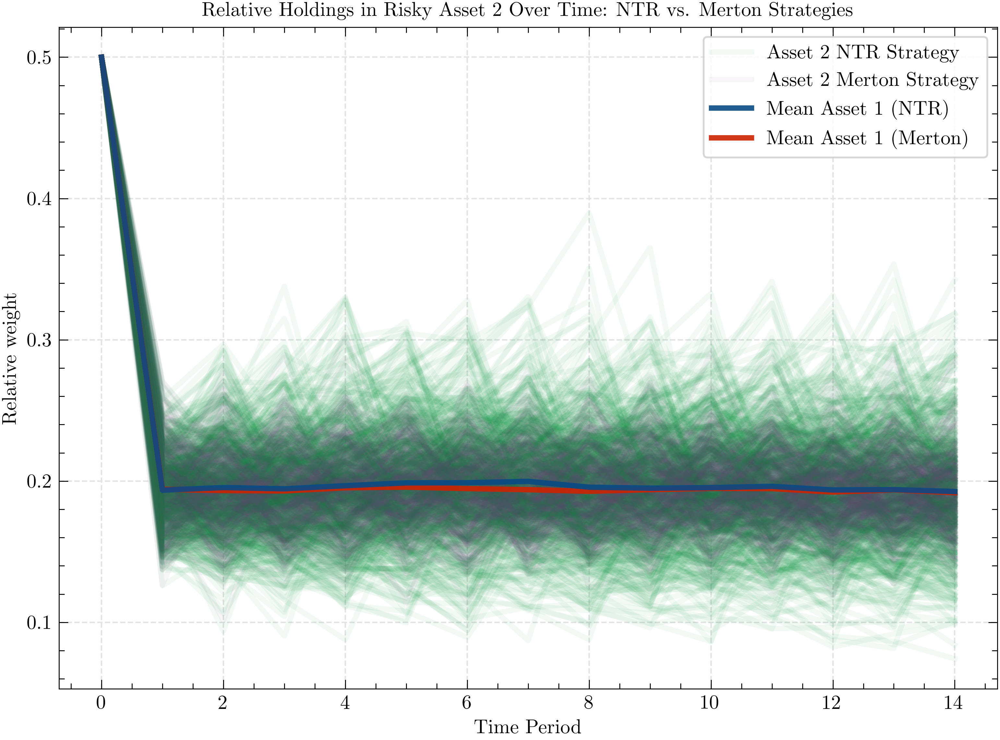

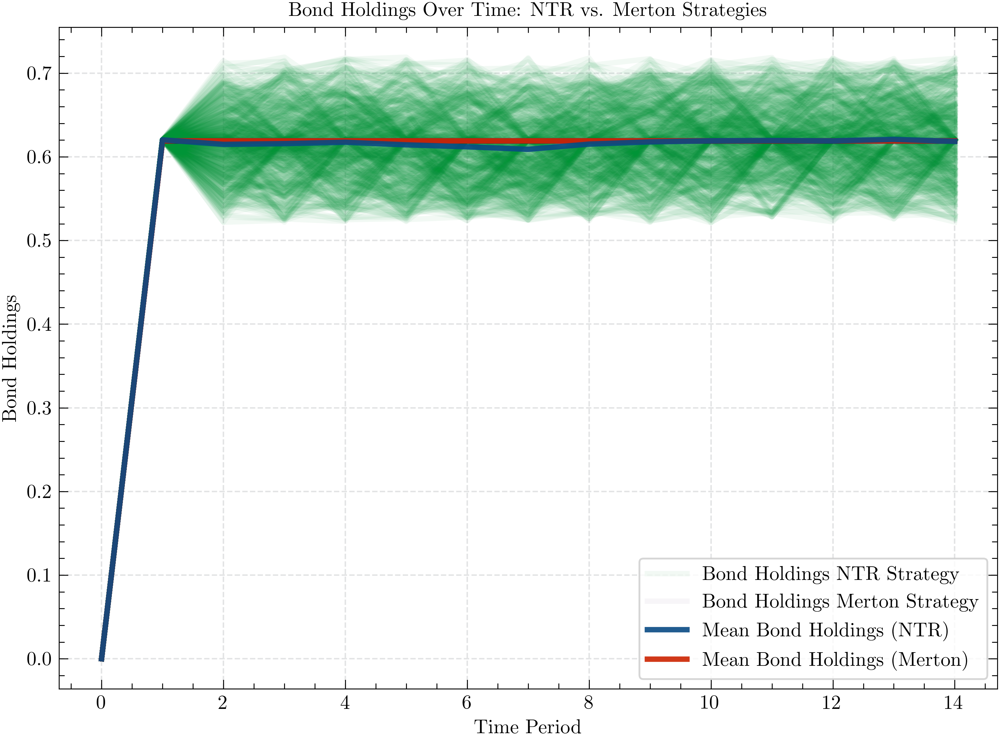

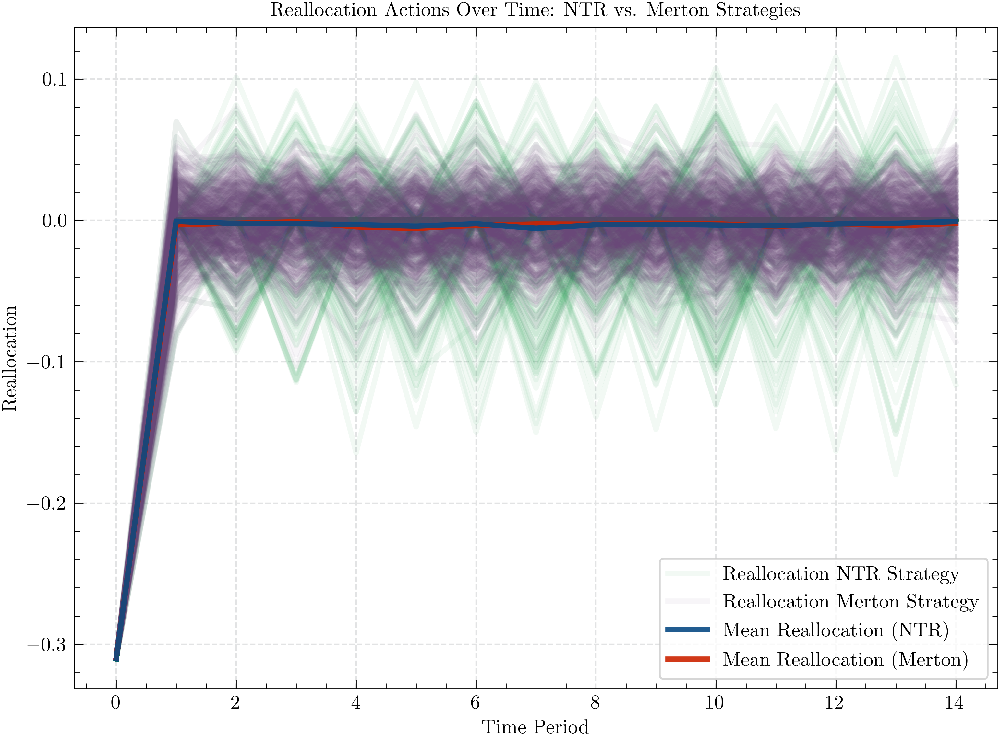

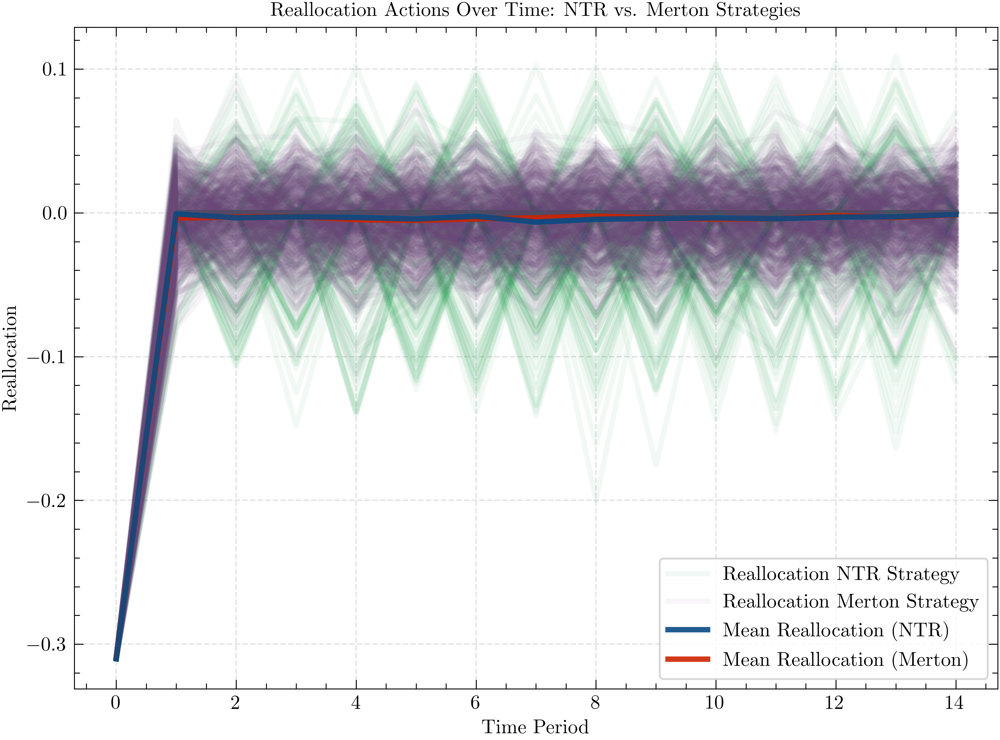

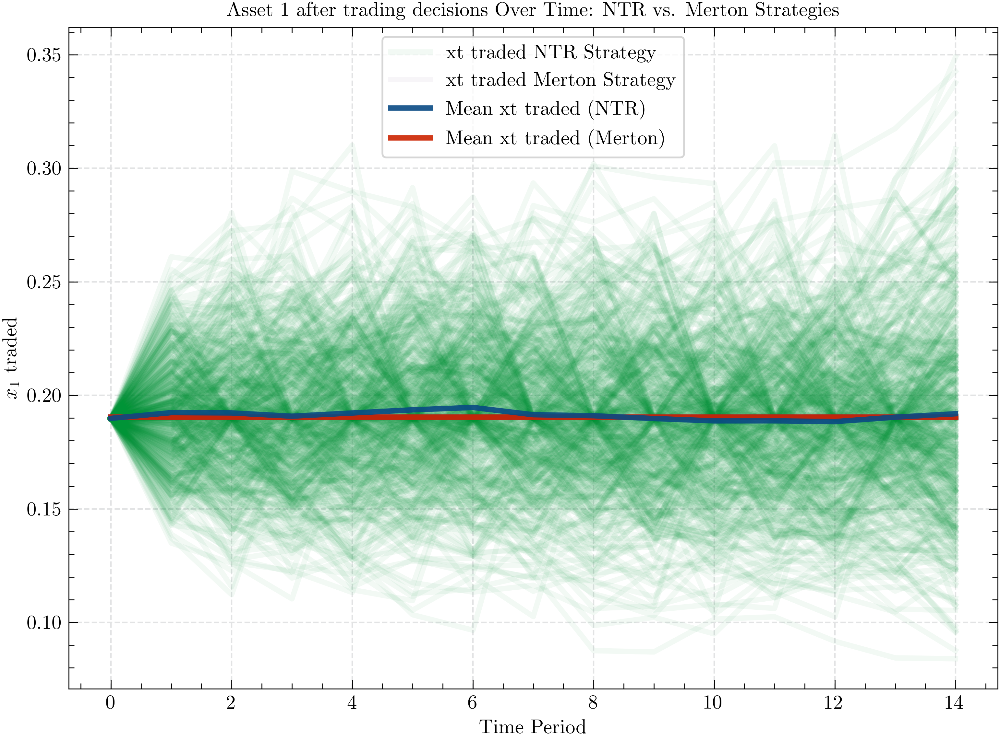

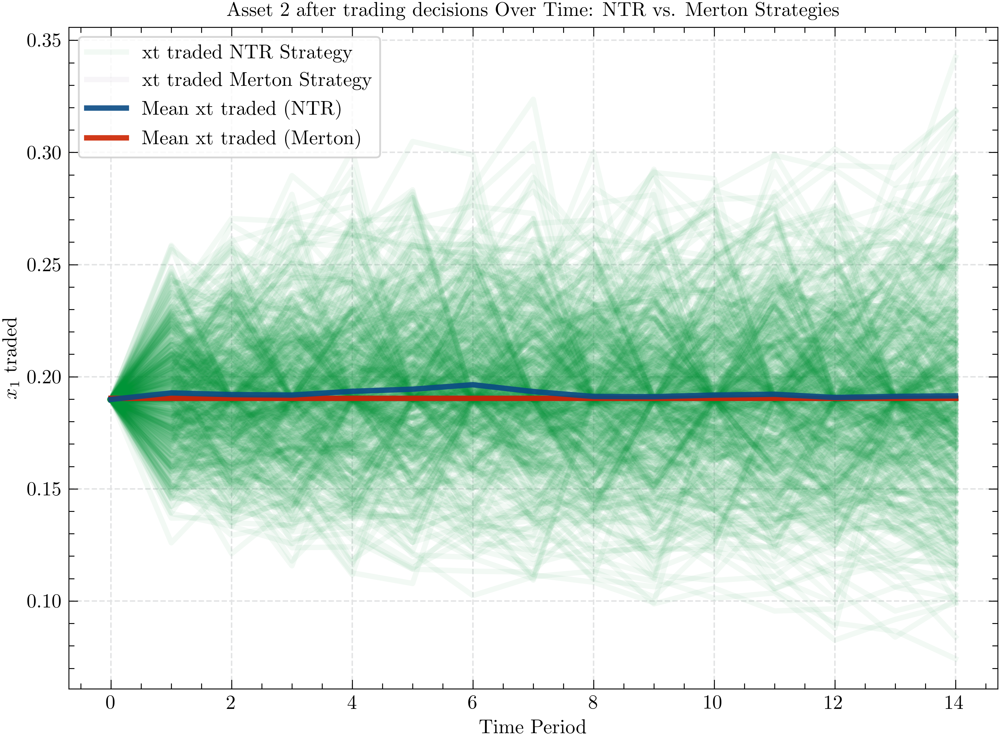

In [756]:
# ----- Define Time Periods -----
time_periods = np.arange(params['T'])  # Shape: (T+1,)
time_periods_delta = np.arange(params['T'])  # Shape: (T,)

# ----- Wealth Over Time -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['Wt'][sim], color = colors[2], alpha=0.05,zorder=2, label='Wealth NTR Strategy')
    else:
        plt.plot(time_periods, results_NTR['Wt'][sim], color = colors[2], alpha=0.05,zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_Merton['Wt'][sim], color = colors[4], alpha=0.05,zorder=2, label='Wealth Merton Strategy')
    else:
        plt.plot(time_periods, results_Merton['Wt'][sim], color = colors[4], alpha=0.05,zorder=2)    

# Plot mean trajectories
plt.plot(time_periods, mean_NTR_Wt, label='Mean Wealth (NTR)',alpha=0.9, linewidth=3,zorder=5)
plt.plot(time_periods, mean_Merton_Wt, label='Mean Wealth (Merton)',alpha=0.9, linewidth=3,zorder=4)

plt.title('Wealth Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Wealth')
# plt.yscale('log')
plt.legend()
# plt.ylim(0, 3500)
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- Holdings in Risky Assets Over Time -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['xt'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2, label='Asset 1 NTR Strategy')
        plt.plot(time_periods, results_Merton['xt'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2, label='Asset 1 Merton Strategy')
    else:
        plt.plot(time_periods, results_NTR['xt'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2)
        plt.plot(time_periods, results_Merton['xt'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2)

plt.plot(time_periods, mean_NTR_xt[:, 0], label='Mean Asset 1 (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(time_periods, mean_Merton_xt[:, 0], label='Mean Asset 1 (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Relative Holdings in Risky Asset 1 Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Relative weight')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['xt'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2, label='Asset 2 NTR Strategy')
        plt.plot(time_periods, results_Merton['xt'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2, label='Asset 2 Merton Strategy')
    else:
        plt.plot(time_periods, results_NTR['xt'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2)
        plt.plot(time_periods, results_Merton['xt'][sim][:,1], color=colors[4], alpha=0.05, zorder=2)

plt.plot(time_periods, mean_NTR_xt[:, 1], label='Mean Asset 1 (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(time_periods, mean_Merton_xt[:, 1], label='Mean Asset 1 (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Relative Holdings in Risky Asset 2 Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Relative weight')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- Bond Holdings Over Time -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['bt'][sim], color=colors[2], alpha=0.05, zorder=2, label='Bond Holdings NTR Strategy')
    else:
        plt.plot(time_periods, results_NTR['bt'][sim], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_Merton['bt'][sim], color=colors[4], alpha=0.05, zorder=2, label='Bond Holdings Merton Strategy')
    else:
        plt.plot(time_periods, results_Merton['bt'][sim], color=colors[4], alpha=0.05, zorder=2)

plt.plot(time_periods, mean_NTR_bt, label='Mean Bond Holdings (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(time_periods, mean_Merton_bt, label='Mean Bond Holdings (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Bond Holdings Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Bond Holdings')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- Reallocation Actions (Delta) Over Time -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2, label='Reallocation NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2, label='Reallocation Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_delta[:, 0], label='Mean Reallocation (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_delta[:, 0], label='Mean Reallocation (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Reallocation Actions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Reallocation')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
# ----- Reallocation Actions (Delta) Over Time -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2, label='Reallocation NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['delta'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2, label='Reallocation Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['delta'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_delta[:, 1], label='Mean Reallocation (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_delta[:, 1], label='Mean Reallocation (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Reallocation Actions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Reallocation')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- xt traded Over Time -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2, label='xt traded NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 0], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2, label='xt traded Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 0], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_xt_traded[:, 0], label='Mean xt traded (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_xt_traded[:, 0], label='Mean xt traded (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Asset 1 after trading decisions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('$x_{{1}}$ traded')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- xt traded Over Time -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2, label='xt traded NTR Strategy')
    else:
        plt.plot(np.arange(T), results_NTR['xt_traded'][sim][:, 1], color=colors[2], alpha=0.05, zorder=2)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2, label='xt traded Merton Strategy')
    else:
        plt.plot(np.arange(T), results_Merton['xt_traded'][sim][:, 1], color=colors[4], alpha=0.05, zorder=2)

plt.plot(np.arange(T), mean_NTR_xt_traded[:, 1], label='Mean xt traded (NTR)', alpha=0.9, linewidth=3, zorder=5)
plt.plot(np.arange(T), mean_Merton_xt_traded[:, 1], label='Mean xt traded (Merton)', alpha=0.9, linewidth=3, zorder=4)

plt.title('Asset 2 after trading decisions Over Time: NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('$x_{{1}}$ traded')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()





# dollar amounts 

In [ ]:
# ----- Asset 1 Holdings Over Time (Dollar Amounts) -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['xt'][sim][:, 0], 
                 color=colors[2], alpha=0.05, zorder=2, label='Asset 1 Holdings NTR Strategy')
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['xt'][sim][:, 0], 
                 color=colors[4], alpha=0.05, zorder=2, label='Asset 1 Holdings Merton Strategy')
    else:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['xt'][sim][:, 0], 
                 color=colors[2], alpha=0.05, zorder=2)
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['xt'][sim][:, 0], 
                 color=colors[4], alpha=0.05, zorder=2)

# Calculate mean dollar holdings
mean_NTR_asset1_dollar = mean_NTR_xt[:, 0] * mean_NTR_Wt
mean_Merton_asset1_dollar = mean_Merton_xt[:, 0] * mean_Merton_Wt

plt.plot(time_periods, mean_NTR_asset1_dollar, label='Mean Asset 1 Holdings (NTR)', 
         alpha=0.9, linewidth=3, zorder=5)
plt.plot(time_periods, mean_Merton_asset1_dollar, label='Mean Asset 1 Holdings (Merton)', 
         alpha=0.9, linewidth=3, zorder=4)

plt.title('Asset 1 Holdings Over Time (Dollar Amounts): NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Dollar Holdings in Asset 1')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- Asset 2 Holdings Over Time (Dollar Amounts) -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['xt'][sim][:, 1], 
                 color=colors[2], alpha=0.05, zorder=2, label='Asset 2 Holdings NTR Strategy')
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['xt'][sim][:, 1], 
                 color=colors[4], alpha=0.05, zorder=2, label='Asset 2 Holdings Merton Strategy')
    else:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['xt'][sim][:, 1], 
                 color=colors[2], alpha=0.05, zorder=2)
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['xt'][sim][:, 1], 
                 color=colors[4], alpha=0.05, zorder=2)

# Calculate mean dollar holdings
mean_NTR_asset2_dollar = mean_NTR_xt[:, 1] * mean_NTR_Wt
mean_Merton_asset2_dollar = mean_Merton_xt[:, 1] * mean_Merton_Wt

plt.plot(time_periods, mean_NTR_asset2_dollar, label='Mean Asset 2 Holdings (NTR)', 
         alpha=0.9, linewidth=3, zorder=5)
plt.plot(time_periods, mean_Merton_asset2_dollar, label='Mean Asset 2 Holdings (Merton)', 
         alpha=0.9, linewidth=3, zorder=4)

plt.title('Asset 2 Holdings Over Time (Dollar Amounts): NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Dollar Holdings in Asset 2')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- Bond Holdings Over Time (Dollar Amounts) -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['bt'][sim], 
                 color=colors[2], alpha=0.05, zorder=2, label='Bond Holdings NTR Strategy')
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['bt'][sim], 
                 color=colors[4], alpha=0.05, zorder=2, label='Bond Holdings Merton Strategy')
    else:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['bt'][sim], 
                 color=colors[2], alpha=0.05, zorder=2)
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['bt'][sim], 
                 color=colors[4], alpha=0.05, zorder=2)

# Calculate mean dollar bond holdings
mean_NTR_bond_dollar = mean_NTR_bt * mean_NTR_Wt
mean_Merton_bond_dollar = mean_Merton_bt * mean_Merton_Wt

plt.plot(time_periods, mean_NTR_bond_dollar, label='Mean Bond Holdings (NTR)', 
         alpha=0.9, linewidth=3, zorder=5)
plt.plot(time_periods, mean_Merton_bond_dollar, label='Mean Bond Holdings (Merton)', 
         alpha=0.9, linewidth=3, zorder=4)

plt.title('Bond Holdings Over Time (Dollar Amounts): NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Dollar Bond Holdings')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- Reallocation Actions Over Time (Dollar Amounts) -----
plt.figure(figsize=(8, 6), dpi=400)

for sim in range(N_simulations):
    if sim == 0:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['delta'][sim][:, 0], 
                 color=colors[2], alpha=0.05, zorder=2, label='Reallocation NTR Strategy')
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['delta'][sim][:, 0], 
                 color=colors[4], alpha=0.05, zorder=2, label='Reallocation Merton Strategy')
    else:
        plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['delta'][sim][:, 0], 
                 color=colors[2], alpha=0.05, zorder=2)
        plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['delta'][sim][:, 0], 
                 color=colors[4], alpha=0.05, zorder=2)

# Calculate mean dollar reallocation
mean_NTR_reallocation_dollar = mean_NTR_delta[:, 0] * mean_NTR_Wt
mean_Merton_reallocation_dollar = mean_Merton_delta[:, 0] * mean_Merton_Wt

plt.plot(time_periods, mean_NTR_reallocation_dollar, label='Mean Reallocation (NTR)', 
         alpha=0.9, linewidth=3, zorder=5)
plt.plot(time_periods, mean_Merton_reallocation_dollar, label='Mean Reallocation (Merton)', 
         alpha=0.9, linewidth=3, zorder=4)

plt.title('Reallocation Actions Over Time (Dollar Amounts): NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Dollar Reallocation')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# ----- Combined Holdings Over Time (Dollar Amounts) -----
plt.figure(figsize=(10, 8), dpi=400)

# Asset 1 Holdings
for sim in range(N_simulations):
    plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['xt'][sim][:, 0], 
             color=colors[2], alpha=0.05, zorder=1)
    plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['xt'][sim][:, 0], 
             color=colors[4], alpha=0.05, zorder=1)

plt.plot(time_periods, mean_NTR_asset1_dollar, label='Mean Asset 1 Holdings (NTR)', 
         color=colors[2], linewidth=2, zorder=3)
plt.plot(time_periods, mean_Merton_asset1_dollar, label='Mean Asset 1 Holdings (Merton)', 
         color=colors[4], linewidth=2, zorder=3)

# Asset 2 Holdings
for sim in range(N_simulations):
    plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['xt'][sim][:, 1], 
             color=colors[2], alpha=0.05, zorder=1)
    plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['xt'][sim][:, 1], 
             color=colors[4], alpha=0.05, zorder=1)

plt.plot(time_periods, mean_NTR_asset2_dollar, label='Mean Asset 2 Holdings (NTR)', 
         color=colors[2], linewidth=2, zorder=4)
plt.plot(time_periods, mean_Merton_asset2_dollar, label='Mean Asset 2 Holdings (Merton)', 
         color=colors[4], linewidth=2, zorder=4)

# Bond Holdings
for sim in range(N_simulations):
    plt.plot(time_periods, results_NTR['Wt'][sim] * results_NTR['bt'][sim], 
             color=colors[2], alpha=0.05, zorder=1)
    plt.plot(time_periods, results_Merton['Wt'][sim] * results_Merton['bt'][sim], 
             color=colors[4], alpha=0.05, zorder=1)

plt.plot(time_periods, mean_NTR_bond_dollar, label='Mean Bond Holdings (NTR)', 
         color=colors[2], linewidth=2, zorder=5)
plt.plot(time_periods, mean_Merton_bond_dollar, label='Mean Bond Holdings (Merton)', 
         color=colors[4], linewidth=2, zorder=5)

plt.title('Holdings Over Time (Dollar Amounts): NTR vs. Merton Strategies')
plt.xlabel('Time Period')
plt.ylabel('Dollar Holdings')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()
